###**Patient's Condition Classification Using Drug Reviews**

#####**Business Objective:**

This is a sample dataset which consists of 161297 drug name, condition reviews and ratings from different patients and our goal is to examine how patients are feeling using the drugs their positive and negative experiences so that we can recommend him a suitable drug. By analyzing the reviews, we can understand the drug effectiveness and its side effects.


The dataset provides patient reviews on specific drugs along with related conditions and a 10 star patient rating reflecting overall patient satisfaction.


So in this dataset, we can see many patients conditions but we will focus only on the below, classify the below conditions from the patients reviews


a. Depression


b. High Blood Pressure


c. Diabetes, Type 2


In [1]:
import pandas as pd # data preprocessing
import itertools # confusion matrix
import string
import numpy as np
import seaborn as sns
import csv
from textblob import TextBlob
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import PassiveAggressiveClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn import metrics
import matplotlib.pyplot as plt
%matplotlib inline
# To show all the rows of pandas dataframe
pd.set_option('display.max_rows', None)

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
df=pd.read_csv('/content/drive/MyDrive/Colab Notebooks/drugsCom_raw (1).tsv',sep='\t')

In [4]:
df.to_csv('drugsCom_raw (1).csv',index=False)

In [5]:
df.head()

,Unnamed: 0,drugName,condition,review,rating,date,usefulCount
0,206461,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combinati...",9.0,"May 20, 2012",27
1,95260,Guanfacine,ADHD,"""My son is halfway through his fourth week of ...",8.0,"April 27, 2010",192
2,92703,Lybrel,Birth Control,"""I used to take another oral contraceptive, wh...",5.0,"December 14, 2009",17
3,138000,Ortho Evra,Birth Control,"""This is my first time using any form of birth...",8.0,"November 3, 2015",10
4,35696,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around...",9.0,"November 27, 2016",37


# **EDA**

In [6]:
df.columns

Index(['Unnamed: 0', 'drugName', 'condition', 'review', 'rating', 'date',
       'usefulCount'],
      dtype='object')

In [7]:
# describing the data
df.describe()

,Unnamed: 0,rating,usefulCount
count,161297.000000,161297.000000,161297.000000
mean,115923.585305,6.994377,28.004755
std,67004.445170,3.272329,36.403742
min,2.000000,1.000000,0.000000
25%,58063.000000,5.000000,6.000000
50%,115744.000000,8.000000,16.000000
75%,173776.000000,10.000000,36.000000
max,232291.000000,10.000000,1291.000000


In [8]:
# taking out information from the data

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 161297 entries, 0 to 161296
Data columns (total 7 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   Unnamed: 0   161297 non-null  int64  
 1   drugName     161297 non-null  object 
 2   condition    160398 non-null  object 
 3   review       161297 non-null  object 
 4   rating       161297 non-null  float64
 5   date         161297 non-null  object 
 6   usefulCount  161297 non-null  int64  
dtypes: float64(1), int64(2), object(4)
memory usage: 8.6+ MB


In [9]:
df.isnull().sum()

Unnamed: 0       0
drugName         0
condition      899
review           0
rating           0
date             0
usefulCount      0
dtype: int64

**Insights**

Most of the missing values are in the condition column.

This implies that most people dont know their condition by name or privacy.


**Questions on Drugs**

1.   How many drugs do we have?




In [10]:
df['drugName'].unique().tolist()

['Valsartan',
 'Guanfacine',
 'Lybrel',
 'Ortho Evra',
 'Buprenorphine / naloxone',
 'Cialis',
 'Levonorgestrel',
 'Aripiprazole',
 'Keppra',
 'Ethinyl estradiol / levonorgestrel',
 'Topiramate',
 'L-methylfolate',
 'Pentasa',
 'Dextromethorphan',
 'Nexplanon',
 'Liraglutide',
 'Trimethoprim',
 'Amitriptyline',
 'Lamotrigine',
 'Nilotinib',
 'Atripla',
 'Trazodone',
 'Etonogestrel',
 'Etanercept',
 'Tioconazole',
 'Azithromycin',
 'Eflornithine',
 'Daytrana',
 'Ativan',
 'Imitrex',
 'Sertraline',
 'Toradol',
 'Viberzi',
 'Mobic',
 'Dulcolax',
 'Morphine',
 'MoviPrep',
 'Trilafon',
 'Fluconazole',
 'Contrave',
 'Clonazepam',
 'Metaxalone',
 'Venlafaxine',
 'Ledipasvir / sofosbuvir',
 'Symbyax',
 'Tamsulosin',
 'Doxycycline',
 'Dulaglutide',
 'Intuniv',
 'Buprenorphine',
 'Qvar',
 'Opdivo',
 'Pyridium',
 'Latuda',
 'Bupropion',
 'Implanon',
 'Effexor XR',
 'Drospirenone / ethinyl estradiol',
 'NuvaRing',
 'Prepopik',
 'Tretinoin',
 'Gildess Fe 1 / 20',
 'Ethinyl estradiol / norgestimate'

In [11]:
len(df['drugName'].unique().tolist())

3436


2.   Which is the most popular drugs?



In [12]:
df['drugName'].value_counts()

Levonorgestrel                                                                                      3657
Etonogestrel                                                                                        3336
Ethinyl estradiol / norethindrone                                                                   2850
Nexplanon                                                                                           2156
Ethinyl estradiol / norgestimate                                                                    2117
Ethinyl estradiol / levonorgestrel                                                                  1888
Phentermine                                                                                         1543
Sertraline                                                                                          1360
Escitalopram                                                                                        1292
Mirena                                                 

In [13]:
#Top 20 drugs that are most popular
df['drugName'].value_counts().nlargest(20)

Levonorgestrel                        3657
Etonogestrel                          3336
Ethinyl estradiol / norethindrone     2850
Nexplanon                             2156
Ethinyl estradiol / norgestimate      2117
Ethinyl estradiol / levonorgestrel    1888
Phentermine                           1543
Sertraline                            1360
Escitalopram                          1292
Mirena                                1242
Implanon                              1102
Gabapentin                            1047
Bupropion                             1022
Venlafaxine                           1016
Miconazole                            1000
Medroxyprogesterone                    995
Citalopram                             995
Lexapro                                952
Bupropion / naltrexone                 950
Duloxetine                             934
Name: drugName, dtype: int64

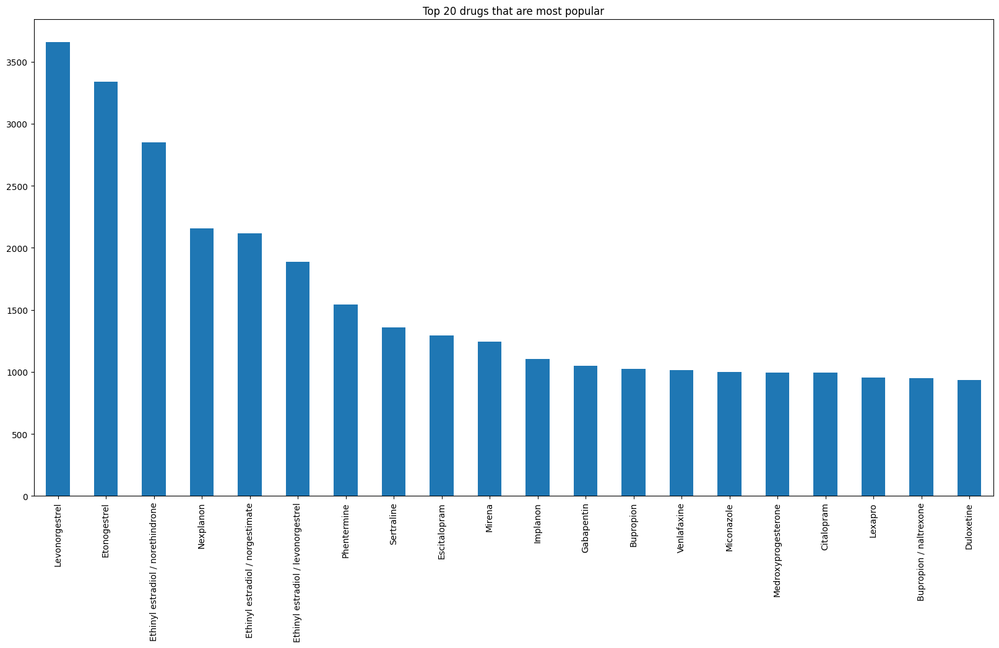

In [14]:
#Top 20 drugs that are most popular
plt.figure(figsize=(20,10))
df['drugName'].value_counts().nlargest(20).plot(kind='bar')
plt.title("Top 20 drugs that are most popular")
plt.show()

**Insights**

Most of the common drugs are Hormonal Drugs.

In [15]:
#20 drugs that are least popular
df['drugName'].value_counts().nsmallest(20)

Clemastine                         1
Topicort LP                        1
Smoothie Readi-Cat 2               1
Ipratropium Inhalation Solution    1
Olux-E                             1
Hexachlorophene                    1
Pedi-Dri                           1
Ginseng                            1
Lincocin                           1
EnLyte                             1
Tums Smoothies                     1
Purinethol                         1
Aldomet                            1
Midol Extended Relief              1
Travel-Eze                         1
Ponatinib                          1
Wal-finate                         1
Ciclodan                           1
Niacinamide                        1
Fragmin                            1
Name: drugName, dtype: int64

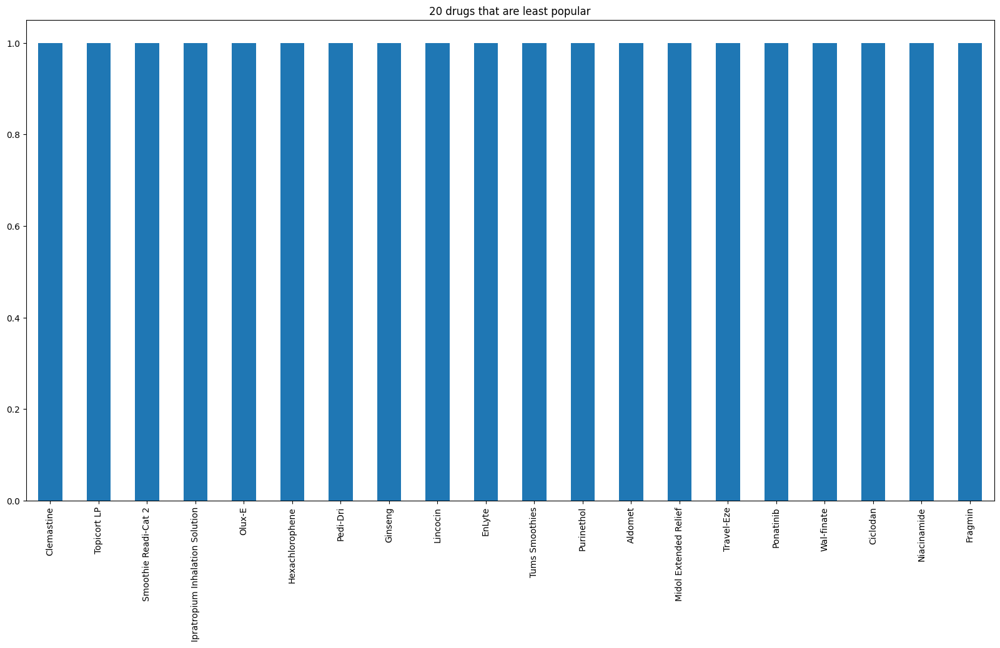

In [16]:
#20 drugs that are least popular
plt.figure(figsize=(20,10))
df['drugName'].value_counts().nsmallest(20).plot(kind='bar')
plt.title("20 drugs that are least popular")
plt.show()


3. What are the groups/classification of drugs used?



In [17]:
drug_suffix={"afil":"phosphodiesterase (PDE) inhibitor","asone":"corticosteroid","bicin":"antineoplastic; cytotoxic agent","bital":"barbiturate (sedative)","caine":"local anesthetic","cef":"cephalosporin antibiotic","ceph":"cephalosporin antibiotic","cillin":"penicillin antibiotic","cort":"corticosteroid","cycline":"tetracycline antibiotic","dazole":"anthelmintic; antibiotic; antibacterial","dipine":"calcium channel blocker","dronate":"bisphosphonate; bone resorption inhibitor","eprazole":"proton pump inhibitor (PPI)","fenac":"NSAID","floxacin":"quinolone antibiotic","gliptin":"antidiabetic; inhibitor of the DPP-4 enzyme","glitazone":"antidiabetic; thiazolidinedione","iramine":"antihistamine","lamide":"carbonic anhydrase inhibitor","mab":"monoclonal antibody","mustine":"alkylating agent (antineoplastic)","mycin":"antibiotic; antibacterial","nacin":"	muscarinic antagonist (anticholinergic)","nazole":"antifungal","olol":"beta blocker","olone":"	corticosteroid","olone":"anabolic steroid","onide":"corticosteroid","oprazole":"proton pump inhibitor (PPI)","parin; -parin":"antithrombotic; anticoagulant (blood thinner)","phylline":"xanthine derivative (bronchodilator)","pramine":"tricyclic antidepressant (TCA)","pred":"corticosteroid","pril":"ACE inhibitor","profen":"NSAID","ridone":"	atypical antipsychotic","sartan":"angiotensin II receptor antagonist; ARB","semide":"loop diuretic (water pill)","setron":"serotonin 5-HT3 receptor antagonist","statin":"HMG-CoA reductase inhibitor; statins","sulfa":"antibiotic; anti-infective; anti-inflammatory","tadine":"antihistamine"}

In [18]:
def classify_drug(drugname):
  for i in drug_suffix.keys():
    if drugname.endswith(i):
      print(True)
      print(drug_suffix[i])

In [19]:
classify_drug('Valsartan')

True
angiotensin II receptor antagonist; ARB


In [20]:
def classify_drug(drugname):
  for i in drug_suffix.keys():
    if drugname.endswith(i):
      return drug_suffix[i]

In [21]:
df['drug_class']=df['drugName'].apply(classify_drug)

In [22]:
df.head(50)

,Unnamed: 0,drugName,condition,review,rating,date,usefulCount,drug_class
0,206461,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combinati...",9.0,"May 20, 2012",27,angiotensin II receptor antagonist; ARB
1,95260,Guanfacine,ADHD,"""My son is halfway through his fourth week of ...",8.0,"April 27, 2010",192,None
2,92703,Lybrel,Birth Control,"""I used to take another oral contraceptive, wh...",5.0,"December 14, 2009",17,None
3,138000,Ortho Evra,Birth Control,"""This is my first time using any form of birth...",8.0,"November 3, 2015",10,None
4,35696,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around...",9.0,"November 27, 2016",37,None
5,155963,Cialis,Benign Prostatic Hyperplasia,"""2nd day on 5mg started to work with rock hard...",2.0,"November 28, 2015",43,None
6,165907,Levonorgestrel,Emergency Contraception,"""He pulled out, but he cummed a bit in me. I t...",1.0,"March 7, 2017",5,None
7,102654,Aripiprazole,Bipolar Disorde,"""Abilify changed my life. There is hope. I was...",10.0,"March 14, 2015",32,None
8,74811,Keppra,Epilepsy,""" I Ve had nothing but problems with the Kepp...",1.0,"August 9, 2016",11,None
9,48928,Ethinyl estradiol / levonorgestrel,Birth Control,"""I had been on the pill for many years. When m...",8.0,"December 8, 2016",1,None


In [23]:
#How many groups of drugs by class
df['drug_class'].unique().tolist()

['angiotensin II receptor antagonist; ARB',
 None,
 'antifungal',
 'antibiotic; antibacterial',
 'tetracycline antibiotic',
 'phosphodiesterase (PDE) inhibitor',
 'beta blocker',
 'quinolone antibiotic',
 'tricyclic antidepressant (TCA)',
 'antihistamine',
 'ACE inhibitor',
 'proton pump inhibitor (PPI)',
 'anthelmintic; antibiotic; antibacterial',
 'monoclonal antibody',
 '\tatypical antipsychotic',
 'NSAID',
 'antidiabetic; inhibitor of the DPP-4 enzyme',
 'corticosteroid',
 'HMG-CoA reductase inhibitor; statins',
 'bisphosphonate; bone resorption inhibitor',
 'penicillin antibiotic',
 'serotonin 5-HT3 receptor antagonist',
 'barbiturate (sedative)',
 'calcium channel blocker',
 'carbonic anhydrase inhibitor',
 'anabolic steroid',
 'loop diuretic (water pill)',
 '\tmuscarinic antagonist (anticholinergic)',
 'local anesthetic',
 'cephalosporin antibiotic',
 'antidiabetic; thiazolidinedione',
 'alkylating agent (antineoplastic)',
 'antineoplastic; cytotoxic agent',
 'xanthine derivativ

In [24]:
len(df['drug_class'].unique().tolist())

34

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9 (	) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


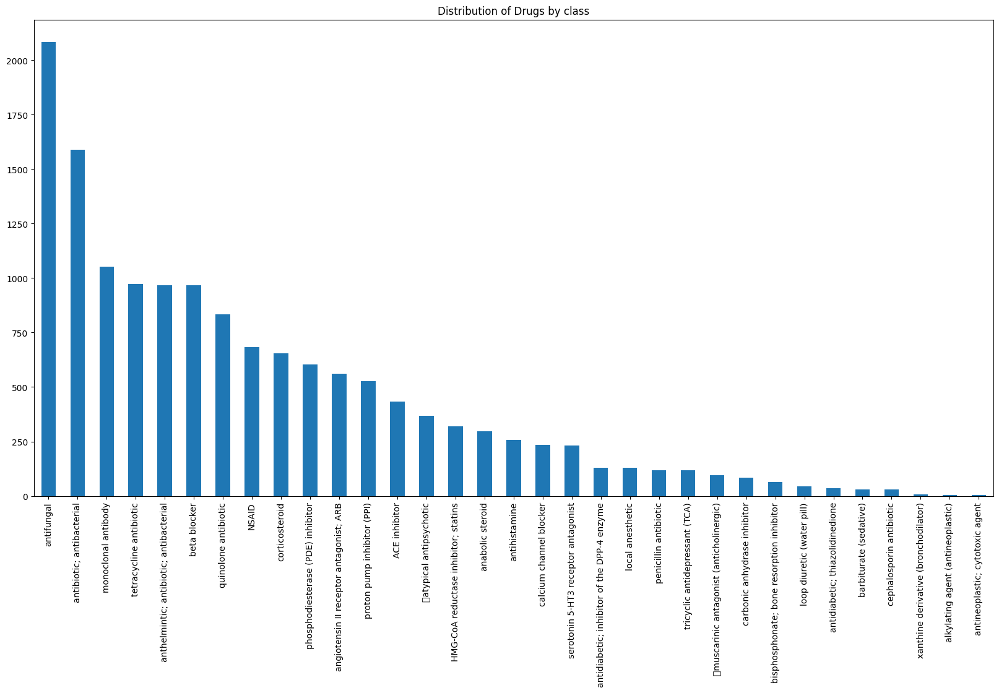

In [25]:
#Which class of drugs is most common
plt.figure(figsize=(20,10))
df['drug_class'].value_counts().plot(kind='bar')
plt.title("Distribution of Drugs by class")
plt.show()

**Insights**

The most common class of drugs are


1.   Antifungal
2.   Antibiotics
3.   Tetracycline Antibiotic(Respiratory Infection)
4.   Anthelmintics(Parasitic Infections)
5.   Monoclonal Antibodies(Cancer)
6.   Beta Blocker(Blood Pressure)



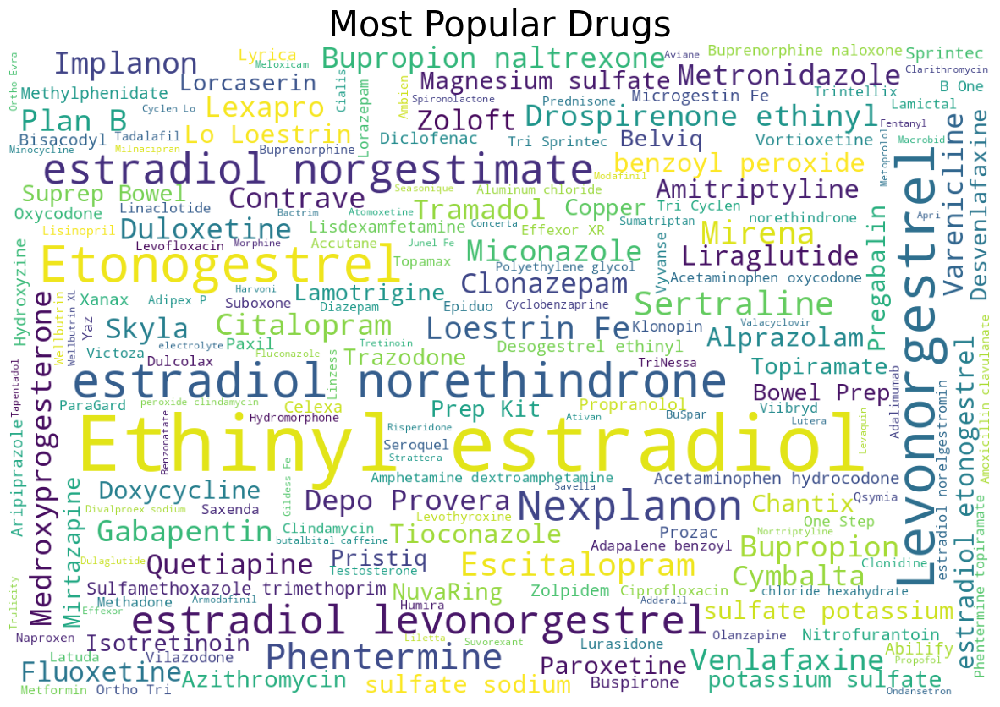

In [26]:
# most popular drugs

from wordcloud import WordCloud
from wordcloud import STOPWORDS

stopwords = set(STOPWORDS)

wordcloud = WordCloud(background_color = 'white', stopwords = stopwords, width = 1200, height = 800).generate(str(df['drugName']))

plt.rcParams['figure.figsize'] = (15, 15)
plt.title('Most Popular Drugs', fontsize = 30)
print(wordcloud)
plt.axis('off')
plt.imshow(wordcloud)
plt.show()

**Questions on Condition**

1.   How many conditions are there?






In [27]:
df['condition'].unique()

array(['Left Ventricular Dysfunction', 'ADHD', 'Birth Control',
       'Opiate Dependence', 'Benign Prostatic Hyperplasia',
       'Emergency Contraception', 'Bipolar Disorde', 'Epilepsy',
       'Migraine Prevention', 'Depression', "Crohn's Disease", 'Cough',
       'Obesity', 'Urinary Tract Infection', 'ibromyalgia',
       'Chronic Myelogenous Leukemia', 'HIV Infection', 'Insomnia',
       'Rheumatoid Arthritis', 'Vaginal Yeast Infection',
       'Chlamydia Infection', 'Hirsutism', 'Panic Disorde', 'Migraine',
       nan, 'Pain', 'Irritable Bowel Syndrome', 'Osteoarthritis',
       'Constipation', 'Bowel Preparation', 'Psychosis', 'Muscle Spasm',
       'Hepatitis C', 'Overactive Bladde', 'Diabetes, Type 2',
       'Asthma, Maintenance', 'Non-Small Cell Lung Cance',
       'Schizophrenia', 'Dysuria', 'Smoking Cessation', 'Anxiety', 'Acne',
       'emale Infertility', 'Constipation, Acute',
       'Constipation, Drug Induced', 'Erectile Dysfunction',
       'Trigeminal Neuralgia', 'U

In [28]:
len(df['condition'].unique().tolist())

885

**Insights**

We have 885 different types of conditions.

In [29]:
# Distribution of conditions
df['condition'].value_counts()

Birth Control                                                          28788
Depression                                                              9069
Pain                                                                    6145
Anxiety                                                                 5904
Acne                                                                    5588
Bipolar Disorde                                                         4224
Insomnia                                                                3673
Weight Loss                                                             3609
Obesity                                                                 3568
ADHD                                                                    3383
Diabetes, Type 2                                                        2554
Emergency Contraception                                                 2463
High Blood Pressure                                                     2321

<AxesSubplot: >

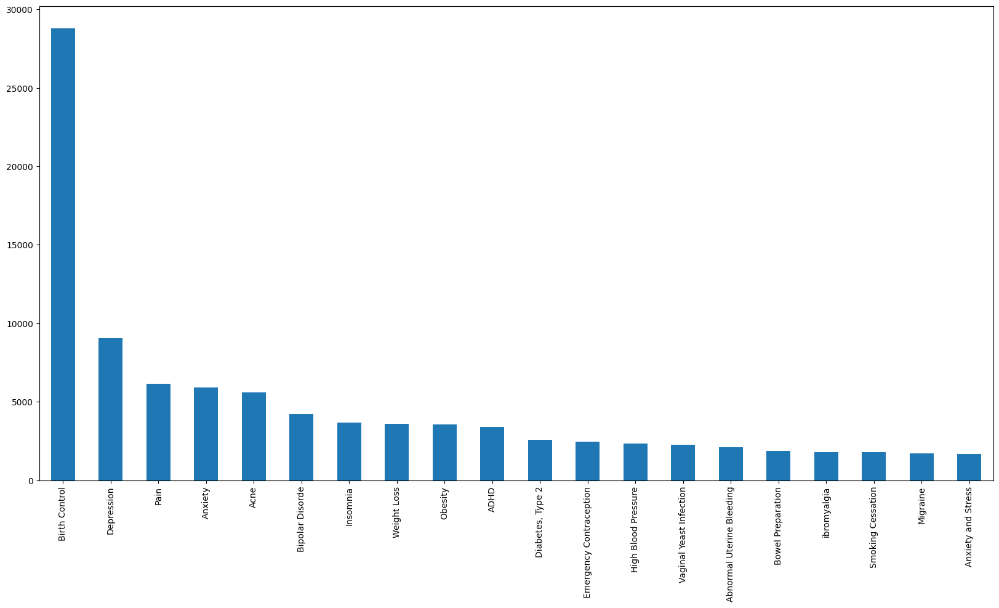

In [30]:
# 20 Most Common conditions
df['condition'].value_counts().nlargest(20).plot(kind='bar',figsize=(20,10))

**Insights**

The most common conditions are


1.   Birth Control
2.   Depression
3.   Pain
4.   Anxiety



In [31]:
# 20 Least Common conditions
df['condition'].value_counts().nsmallest(20)

Meningococcal Meningitis Prophylaxis                     1
mist (                                                   1
Cluster-Tic Syndrome                                     1
Syringomyelia                                            1
Gestational Diabetes                                     1
Aspergillosis, Aspergilloma                              1
Pseudogout, Prophylaxis                                  1
Portal Hypertension                                      1
Reversal of Nondepolarizing Muscle Relaxants             1
47</span> users found this comment helpful.              1
Short Stature for Age                                    1
Neurotic Depression                                      1
Cerebral Edema                                           1
me                                                       1
Hyperuricemia Secondary to Chemotherapy                  1
Prevention of Perinatal Group B Streptococcal Disease    1
Small Bowel or Pancreatic Fistula                       

<AxesSubplot: >

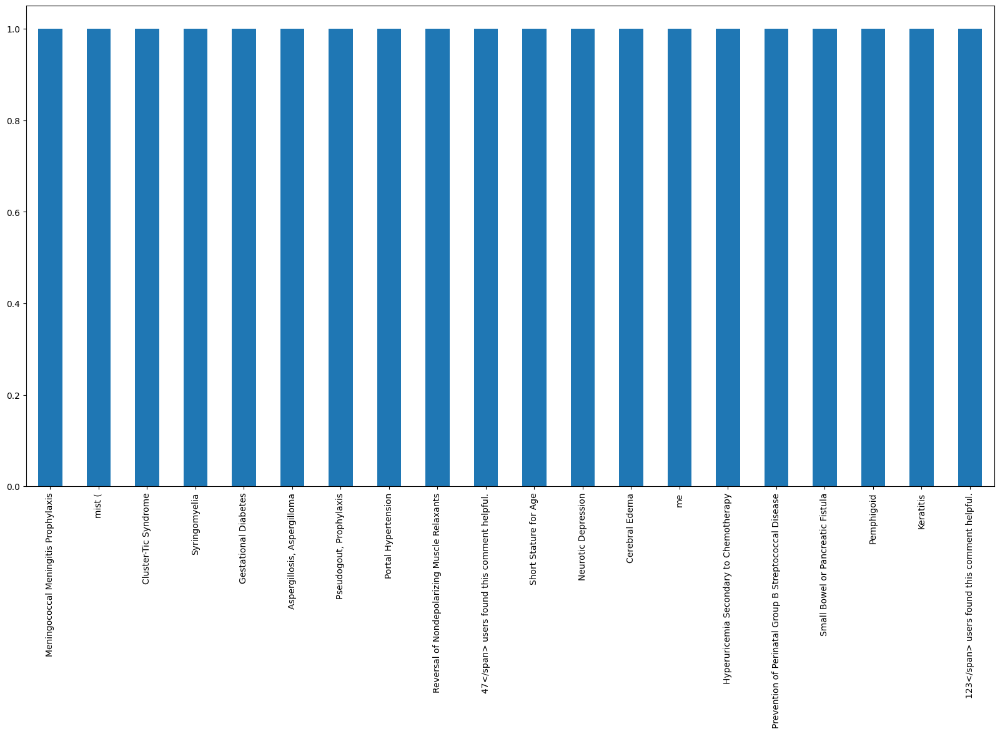

In [32]:
# 20 Least Common conditions
df['condition'].value_counts().nsmallest(20).plot(kind='bar',figsize=(20,10))

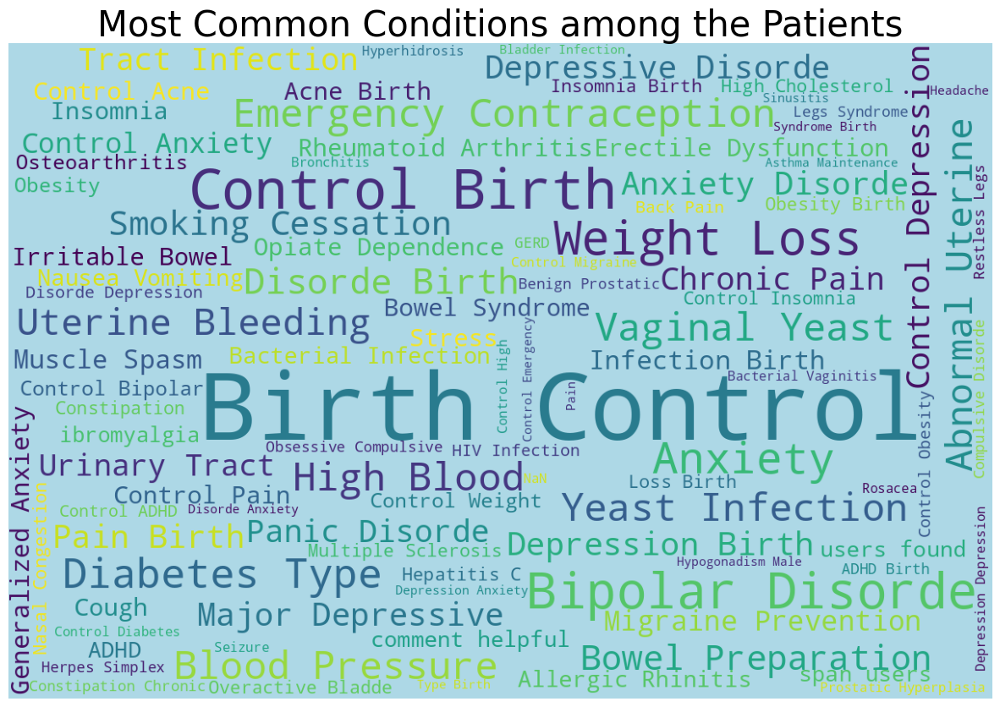

In [33]:

# most common condition

from wordcloud import WordCloud
from wordcloud import STOPWORDS

stopwords = set(STOPWORDS)

wordcloud = WordCloud(background_color = 'lightblue', stopwords = stopwords, max_words = 100, width = 1200, height = 800).generate(str(df['condition']))

plt.rcParams['figure.figsize'] = (15, 15)
plt.title('Most Common Conditions among the Patients', fontsize = 30)
print(wordcloud)
plt.axis('off')
plt.imshow(wordcloud)
plt.show()
     

**Questions on Drugs and Condition**



1.   How many drugs per condition




In [34]:
df.groupby('condition')['drugName'].nunique().nlargest(20)

condition
Not Listed / Othe                             214
Pain                                          200
Birth Control                                 172
High Blood Pressure                           140
Acne                                          117
Depression                                    105
Rheumatoid Arthritis                           98
Diabetes, Type 2                               89
Allergic Rhinitis                              88
Bipolar Disorde                                80
Osteoarthritis                                 80
Anxiety                                        78
Insomnia                                       78
Abnormal Uterine Bleeding                      74
Migraine                                       59
Psoriasis                                      58
3</span> users found this comment helpful.     57
Endometriosis                                  57
ADHD                                           55
Asthma, Maintenance                     

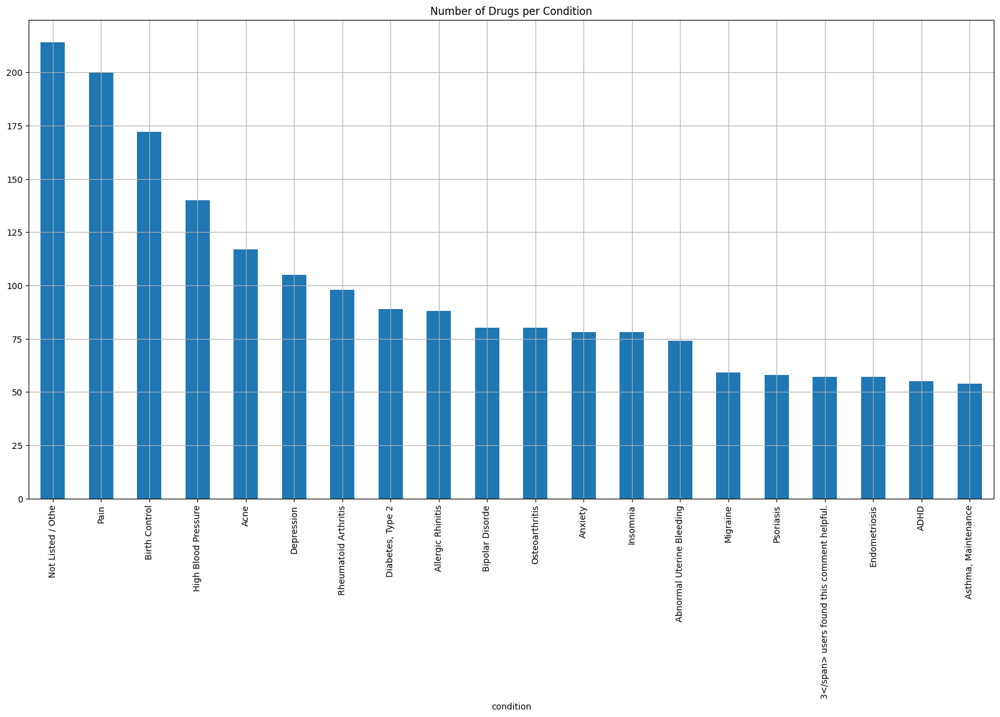

In [35]:
df.groupby('condition')['drugName'].nunique().nlargest(20).plot(kind='bar',figsize=(20,10))
plt.title('Number of Drugs per Condition')
plt.grid()
plt.show()

**Insights**

Pain, Birth Control and High Blood Pressure have the highest number of different/unique drugs for their condition.

In [36]:
# Distribution of Drugs per Drug Group based on size
drug_groups=df.groupby('drug_class').size()

In [37]:
type(drug_groups)

pandas.core.series.Series

In [38]:
# Convert to DF
drug_groups_df=pd.DataFrame({'drug_class':drug_groups.index,'counts':drug_groups.values})

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9 (	) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


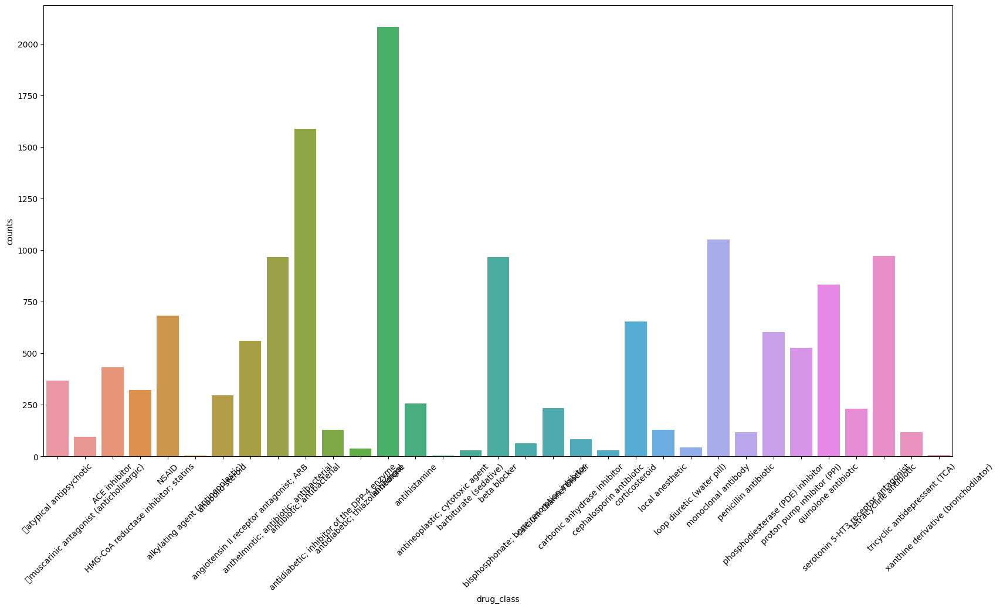

In [39]:
# Seaborn Plot
plt.figure(figsize=(20,10))
g=sns.barplot(data=drug_groups_df,x='drug_class',y='counts')
plt.xticks(rotation=45)
plt.show()

**Questions on Rating**


1.   Distribution of Rating
2.   Average Rating per count



In [40]:
df['rating']

0          9.0
1          8.0
2          5.0
3          8.0
4          9.0
5          2.0
6          1.0
7         10.0
8          1.0
9          8.0
10         9.0
11        10.0
12         4.0
13         4.0
14         3.0
15         9.0
16         9.0
17         9.0
18        10.0
19        10.0
20         8.0
21        10.0
22         9.0
23        10.0
24         1.0
25         7.0
26        10.0
27        10.0
28         6.0
29         8.0
30        10.0
31         8.0
32        10.0
33         1.0
34         8.0
35        10.0
36         1.0
37         8.0
38         2.0
39         9.0
40         8.0
41         8.0
42         9.0
43         5.0
44         4.0
45        10.0
46         9.0
47         8.0
48         4.0
49         7.0
50        10.0
51         1.0
52         8.0
53         1.0
54         1.0
55        10.0
56         1.0
57         8.0
58        10.0
59         2.0
60         6.0
61         3.0
62        10.0
63         1.0
64         5.0
65         9.0
66        

<AxesSubplot: xlabel='rating'>

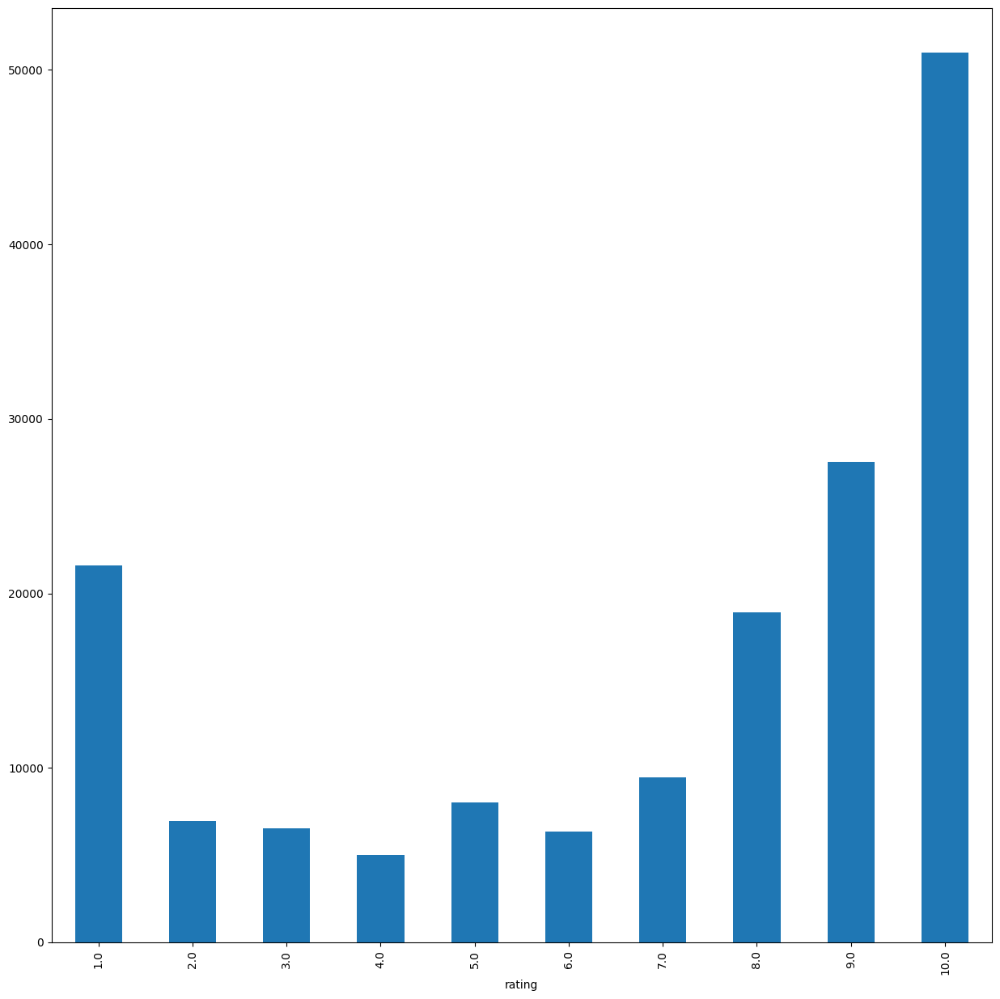

In [41]:
# Distribution of rating by size
df.groupby('rating').size().plot(kind='bar')

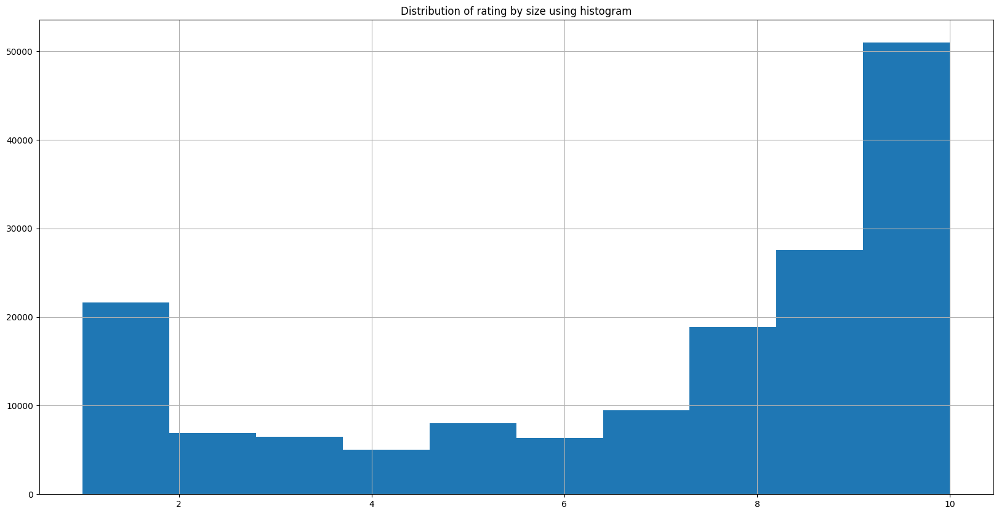

In [42]:
# Distribution of rating by size using histogram
plt.figure(figsize=(20,10))
df['rating'].hist()
plt.title("Distribution of rating by size using histogram")
plt.show()


**Insights**

Most people rated at the extremes i.e. 7 to 10.

In [43]:
# Average rating of the drugs
avg_rating=(df['rating'].groupby(df['drugName']).mean())

In [44]:
avg_rating

drugName
A + D Cracked Skin Relief                                                                           10.000000
A / B Otic                                                                                          10.000000
Abacavir / dolutegravir / lamivudine                                                                 8.211538
Abacavir / lamivudine / zidovudine                                                                   9.000000
Abatacept                                                                                            7.157895
Abilify                                                                                              6.540359
Abilify Discmelt                                                                                     8.000000
Abilify Maintena                                                                                     7.750000
Abiraterone                                                                                          9.111111
A

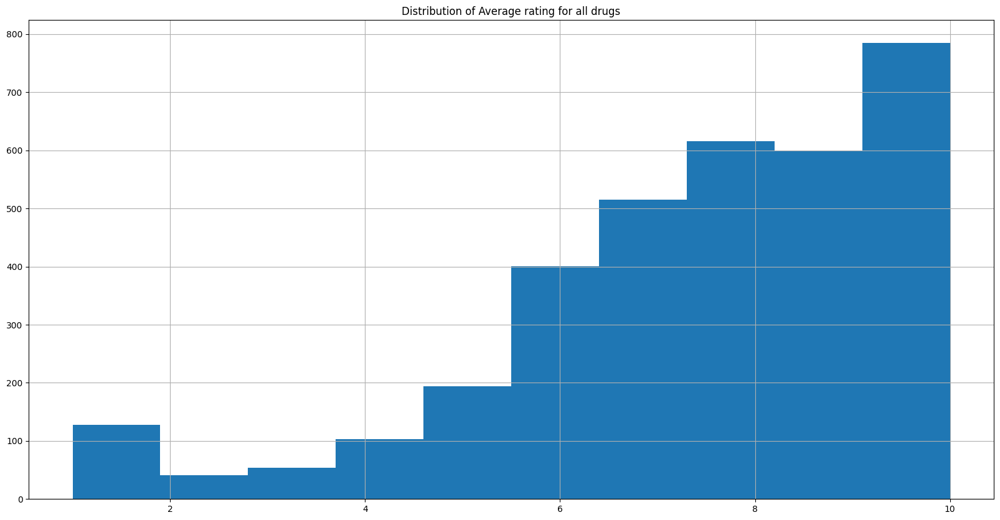

In [45]:
# Average rating for all drugs
plt.figure(figsize=(20,10))
avg_rating.hist()
plt.title("Distribution of Average rating for all drugs")
plt.show()

In [46]:
# Average rating of the drugs by class
avg_rating_per_drug_class=(df['rating'].groupby(df['drug_class']).mean())

In [47]:
avg_rating_per_drug_class

drug_class
\tatypical antipsychotic                       6.305177
\tmuscarinic antagonist (anticholinergic)      6.138298
ACE inhibitor                                  5.759259
HMG-CoA reductase inhibitor; statins           5.809969
NSAID                                          7.929619
alkylating agent (antineoplastic)              9.250000
anabolic steroid                               7.597315
angiotensin II receptor antagonist; ARB        6.464286
anthelmintic; antibiotic; antibacterial        6.837810
antibiotic; antibacterial                      6.733333
antidiabetic; inhibitor of the DPP-4 enzyme    5.376923
antidiabetic; thiazolidinedione                5.000000
antifungal                                     4.210274
antihistamine                                  7.503906
antineoplastic; cytotoxic agent                8.250000
barbiturate (sedative)                         8.896552
beta blocker                                   7.681159
bisphosphonate; bone resorption inhib

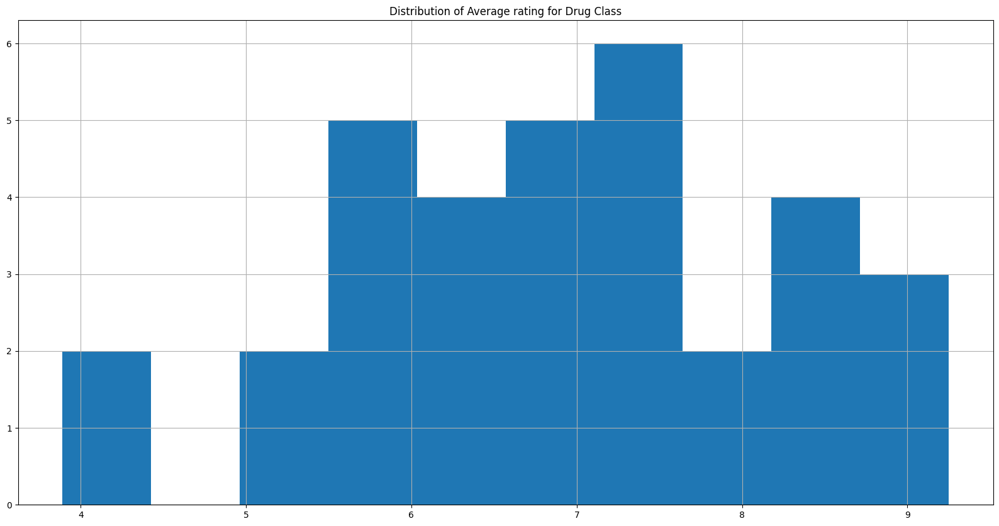

In [48]:
# Average rating for all drugs
plt.figure(figsize=(20,10))
avg_rating_per_drug_class.hist()
plt.title("Distribution of Average rating for Drug Class")
plt.show()

In [49]:
# Which group of drugs have highest average rating
avg_rating_per_drug_class.nlargest(10)

drug_class
alkylating agent (antineoplastic)       9.250000
xanthine derivative (bronchodilator)    9.000000
barbiturate (sedative)                  8.896552
tricyclic antidepressant (TCA)          8.401709
phosphodiesterase (PDE) inhibitor       8.359867
antineoplastic; cytotoxic agent         8.250000
serotonin 5-HT3 receptor antagonist     8.246753
NSAID                                   7.929619
beta blocker                            7.681159
proton pump inhibitor (PPI)             7.625000
Name: rating, dtype: float64

In [50]:
# Which drugs have highest average rating
avg_rating.nlargest(20)

drugName
A + D Cracked Skin Relief                              10.0
A / B Otic                                             10.0
Absorbine Jr.                                          10.0
Accolate                                               10.0
Acetaminophen / caffeine / magnesium salicylate        10.0
Acetaminophen / dextromethorphan / doxylamine          10.0
Acetaminophen / phenylephrine                          10.0
Acetaminophen / pseudoephedrine                        10.0
Acetic acid / antipyrine / benzocaine / polycosanol    10.0
Acrivastine / pseudoephedrine                          10.0
Acyclovir / hydrocortisone                             10.0
Advil Cold and Sinus Liqui-Gels                        10.0
Aerobid-M                                              10.0
Afrin 4 Hour Extra Moisturizing                        10.0
Ala-Quin                                               10.0
Alavert                                                10.0
Aldactazide                    

**Questions on Reviews**


1.   How geniune is the review




In [51]:
from textblob import TextBlob

In [52]:
df['review']

0         "It has no side effect, I take it in combinati...
1         "My son is halfway through his fourth week of ...
2         "I used to take another oral contraceptive, wh...
3         "This is my first time using any form of birth...
4         "Suboxone has completely turned my life around...
5         "2nd day on 5mg started to work with rock hard...
6         "He pulled out, but he cummed a bit in me. I t...
7         "Abilify changed my life. There is hope. I was...
8         " I Ve had  nothing but problems with the Kepp...
9         "I had been on the pill for many years. When m...
10        "I have been on this medication almost two wee...
11        "I have taken anti-depressants for years, with...
12        "I had Crohn&#039;s with a resection 30 years ...
13        "Have a little bit of a lingering cough from a...
14        "Started Nexplanon 2 months ago because I have...
15        "I have been taking Saxenda since July 2016.  ...
16        "This drug worked very well fo

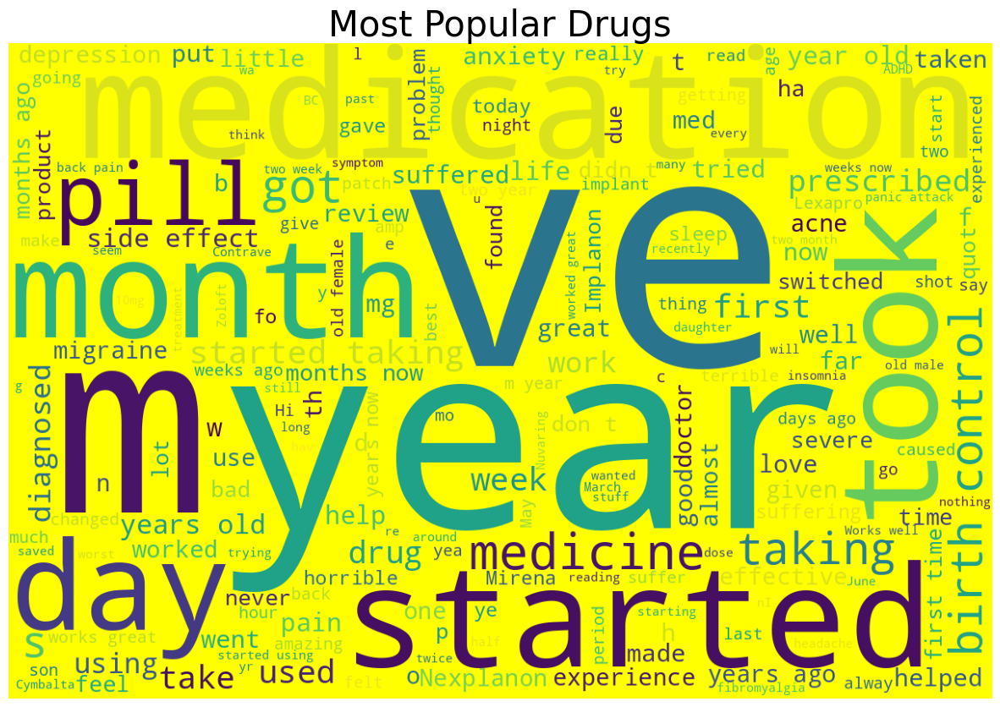

In [53]:
# let's see the words cloud for the reviews 

# most popular drugs

from wordcloud import WordCloud
from wordcloud import STOPWORDS

stopwords = set(STOPWORDS)

wordcloud = WordCloud(background_color = 'yellow', stopwords = stopwords, width = 1200, height = 800).generate(str(df['review']))

plt.rcParams['figure.figsize'] = (15, 15)
plt.title('Most Popular Drugs', fontsize = 30)
print(wordcloud)
plt.axis('off')
plt.imshow(wordcloud)
plt.show()

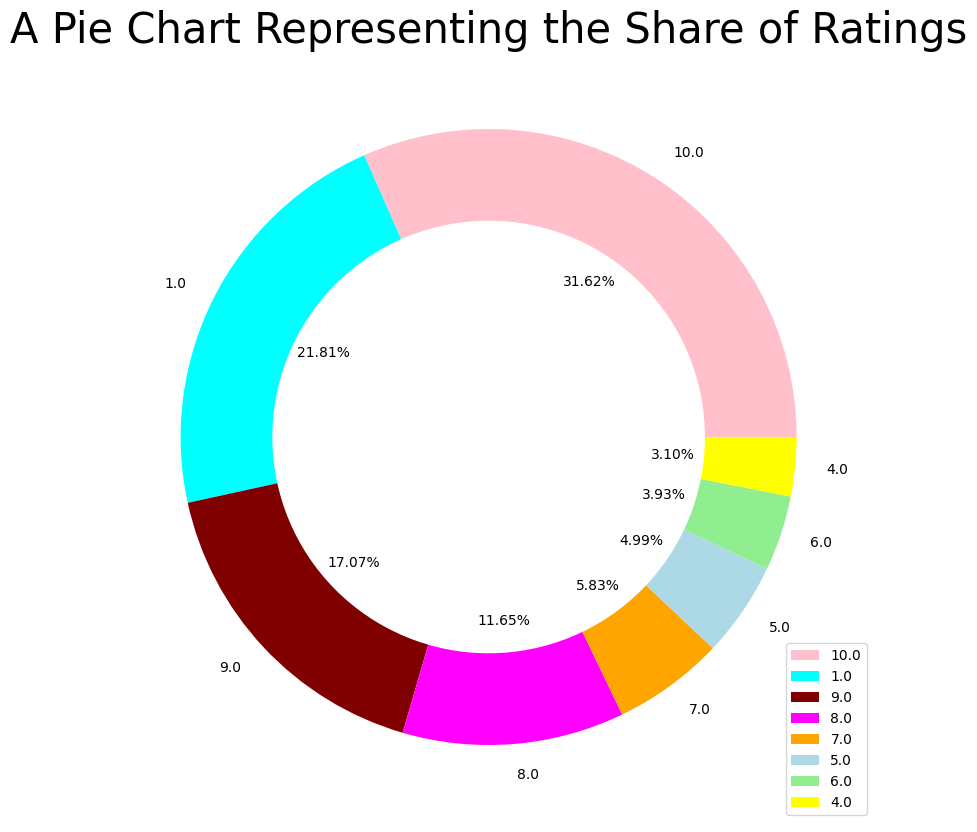

In [54]:
# making a donut chart to represent share of each ratings

size = [68005, 46901, 36708, 25046, 12547, 10723, 8462, 6671]
colors = ['pink', 'cyan', 'maroon',  'magenta', 'orange', 'lightblue', 'lightgreen', 'yellow']
labels = "10.0", "1.0", "9.0", "8.0", "7.0", "5.0", "6.0", "4.0"

my_circle = plt.Circle((0, 0), 0.7, color = 'white')

plt.rcParams['figure.figsize'] = (10, 10)
plt.pie(size, colors = colors, labels = labels, autopct = '%.2f%%')
plt.axis('off')
plt.title('A Pie Chart Representing the Share of Ratings', fontsize = 30)
p = plt.gcf()
plt.gca().add_artist(my_circle)
plt.legend()
plt.show()

In [55]:
def get_sentiment(text):
  blob=TextBlob(text)
  return blob.polarity

def get_sentiment_label(text):
  blob=TextBlob(text)
  if blob.polarity > 0:
    result='positive'
  elif blob.polarity < 0:
    result='negative'
  else:
    result='neutral'
  return result

In [56]:
# Sentiment score for review
df['sentiment']=df['review'].apply(get_sentiment)

In [57]:
# Sentiment labels for review
df['sentiment_label']=df['review'].apply(get_sentiment_label)

In [58]:
df[['review','sentiment','sentiment_label']].head()

,review,sentiment,sentiment_label
0,"""It has no side effect, I take it in combinati...",0.000000,neutral
1,"""My son is halfway through his fourth week of ...",0.168333,positive
2,"""I used to take another oral contraceptive, wh...",0.067210,positive
3,"""This is my first time using any form of birth...",0.179545,positive
4,"""Suboxone has completely turned my life around...",0.194444,positive


In [59]:
#How many positive, negative and neutral reviews
df['sentiment_label'].value_counts()

positive    101041
negative     53303
neutral       6953
Name: sentiment_label, dtype: int64

<AxesSubplot: >

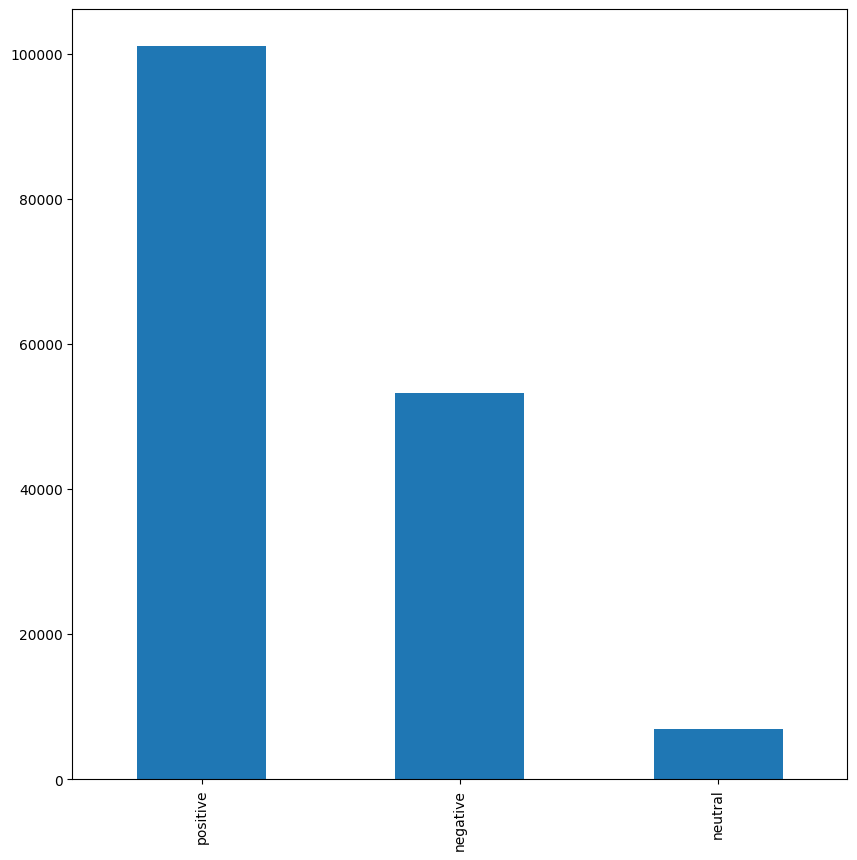

In [60]:
#How many positive, negative and neutral reviews
df['sentiment_label'].value_counts().plot(kind='bar')

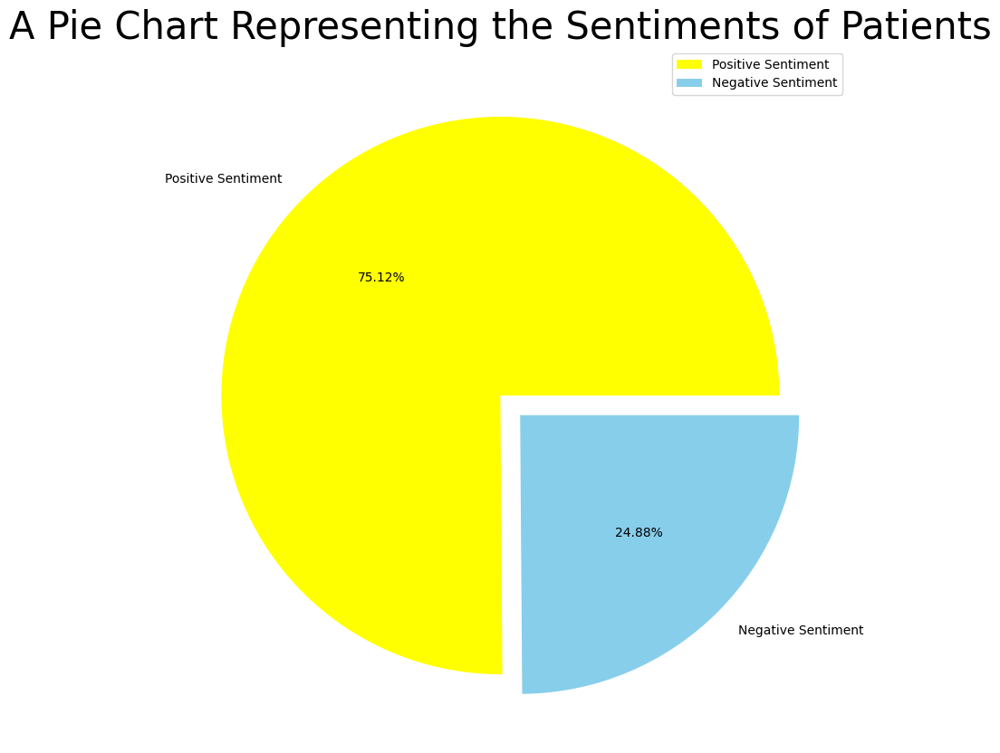

In [61]:
# a pie chart to represent the sentiments of the patients

size = [24224, 8025]
colors = ['yellow', 'skyblue']
labels = "Positive Sentiment","Negative Sentiment"
explode = [0, 0.1]

plt.rcParams['figure.figsize'] = (10, 10)
plt.pie(size, colors = colors, labels = labels, explode = explode, autopct = '%.2f%%')
plt.axis('off')
plt.title('A Pie Chart Representing the Sentiments of Patients', fontsize = 30)
plt.legend()
plt.show()

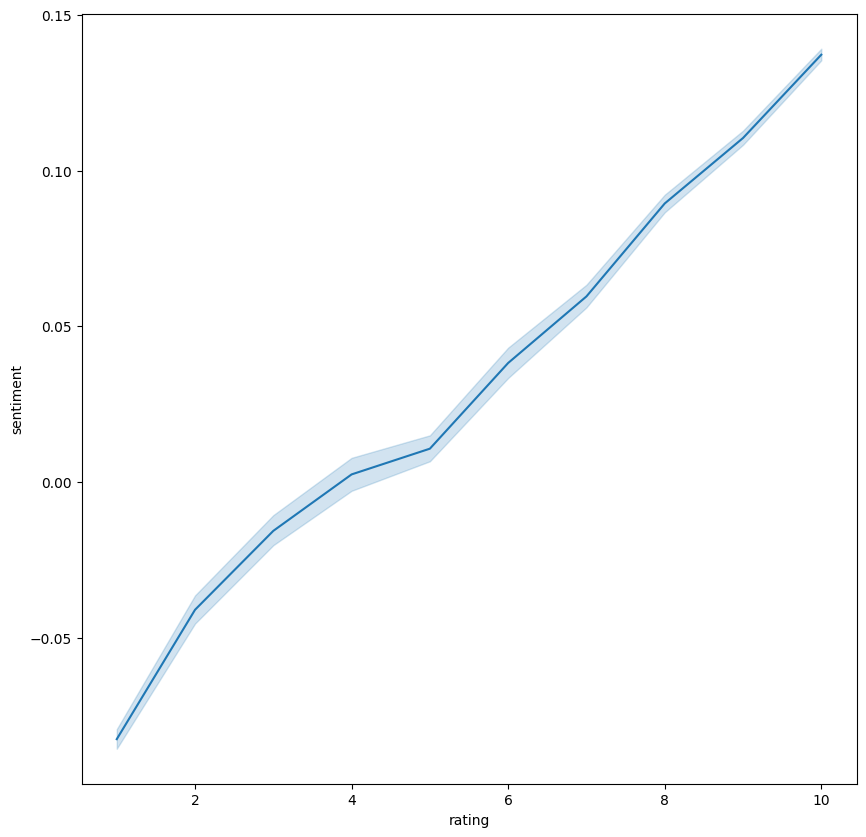

In [62]:
# Corelation between our sentiment and rating
sns.lineplot(data=df,x='rating',y='sentiment')
plt.show()

**Insights**

As the rating increases, the sentiment increases positively.

**Questions on useful count**


1.   No. of users who found review useful
2.   Top useful count by drugs/class
3.   best drugs based on useful count



In [63]:
df.groupby('drugName')['usefulCount'].value_counts()

drugName                                                                                          usefulCount
A + D Cracked Skin Relief                                                                         6                1
A / B Otic                                                                                        20               1
Abacavir / dolutegravir / lamivudine                                                              9                6
                                                                                                  1                5
                                                                                                  12               5
                                                                                                  4                3
                                                                                                  7                3
                                                                       

In [64]:
#Top drugs per useful count
df.groupby('drugName')['usefulCount'].nunique().nlargest(20)

drugName
Fluoxetine       181
Gabapentin       181
Bupropion        177
Citalopram       176
Sertraline       172
Escitalopram     171
Prozac           171
Zoloft           171
Lexapro          169
Celexa           166
Amitriptyline    162
Lorcaserin       157
Trazodone        157
Duloxetine       153
Phentermine      150
Belviq           148
Alprazolam       146
Cymbalta         144
Venlafaxine      144
BuSpar           141
Name: usefulCount, dtype: int64

<AxesSubplot: xlabel='drugName'>

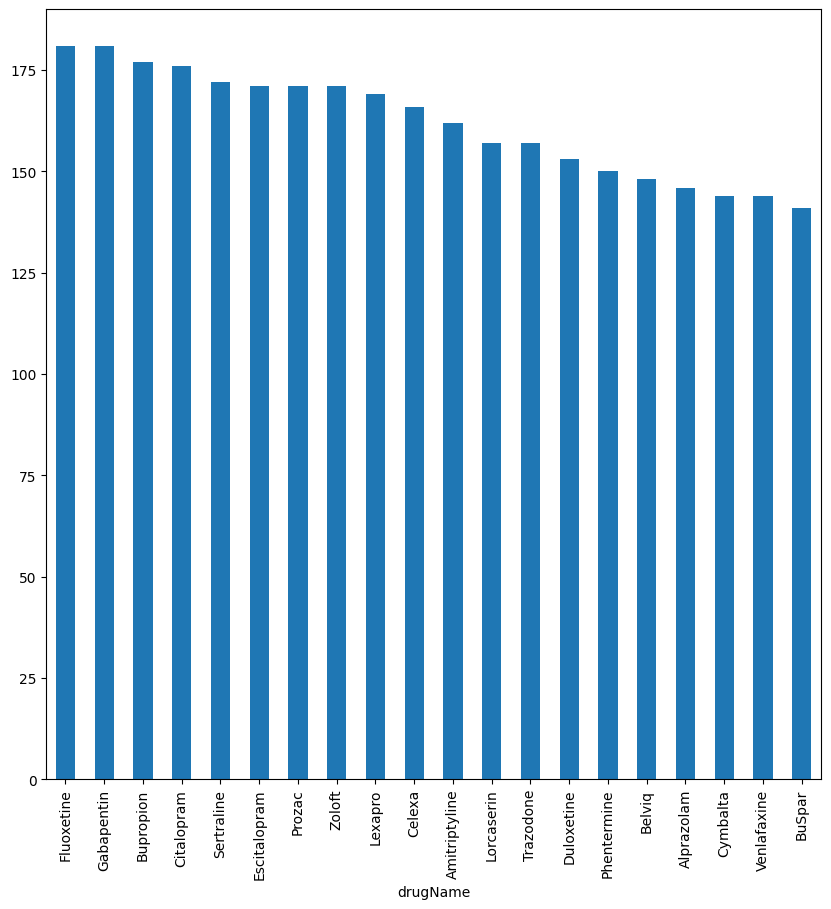

In [65]:
#Top drugs per useful count
df.groupby('drugName')['usefulCount'].nunique().nlargest(20).plot(kind='bar')

<AxesSubplot: xlabel='rating', ylabel='usefulCount'>

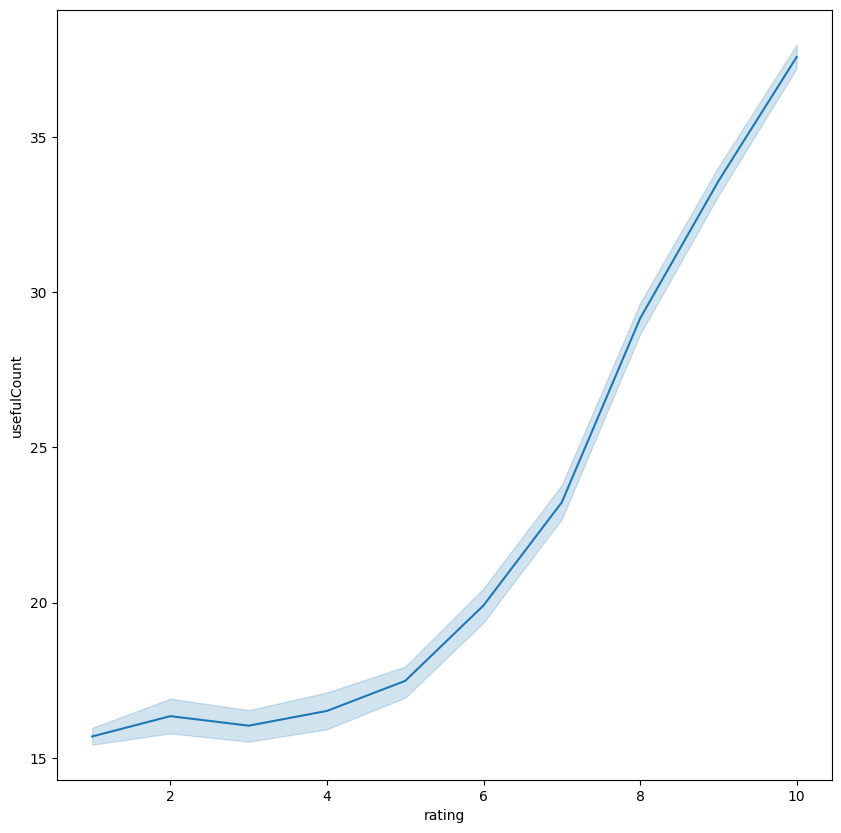

In [66]:
# Corelation between rating and useful count
sns.lineplot(data=df,x='rating',y='usefulCount')

**Insights**

As the rating goes up useful count goes up.

**Auto EDA**

In [67]:
pip install pandas_profiling

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [68]:
from pandas_profiling import ProfileReport
profile = ProfileReport(pd.read_csv('/content/drive/MyDrive/Colab Notebooks/drugsCom_raw (1).tsv',sep='\t'), explorative=True)
profile.to_file("pandas_profiling_report.html")

<ipython-input-68-ae95e4678f8e>:1: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [69]:
pip install sweetviz

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [70]:
import sweetviz as sv
sweet_report = sv.analyze(pd.read_csv('/content/drive/MyDrive/Colab Notebooks/drugsCom_raw (1).tsv',sep='\t'))
sweet_report.show_html('sweet_report.html')

/usr/local/lib/python3.10/dist-packages/sweetviz/dataframe_report.py:74: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  all_source_names = [cur_name for cur_name, cur_series in source_df.iteritems()]
/usr/local/lib/python3.10/dist-packages/sweetviz/dataframe_report.py:109: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  filtered_series_names_in_source = [cur_name for cur_name, cur_series in source_df.iteritems()


                                             |          | [  0%]   00:00 -> (? left)

/usr/local/lib/python3.10/dist-packages/sweetviz/series_analyzer_numeric.py:25: FutureWarning: The 'mad' method is deprecated and will be removed in a future version. To compute the same result, you may do `(df - df.mean()).abs().mean()`.
  stats["mad"] = series.mad()
/usr/local/lib/python3.10/dist-packages/sweetviz/series_analyzer_text.py:19: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for item in to_process.source_counts["value_counts_without_nan"].iteritems():
/usr/local/lib/python3.10/dist-packages/sweetviz/series_analyzer_text.py:19: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for item in to_process.source_counts["value_counts_without_nan"].iteritems():
/usr/local/lib/python3.10/dist-packages/sweetviz/series_analyzer_text.py:19: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for item in to_process.source_counts["

Report sweet_report.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [71]:
df_train = df[(df['condition']=='Depression') | (df['condition']=='High Blood Pressure')|(df['condition']=='Diabetes, Type 2')]


In [72]:
df.shape

(161297, 10)

In [73]:
df_train.shape

(13944, 10)

In [74]:
X = df_train.drop(['Unnamed: 0','drugName','rating','date','usefulCount','drug_class','sentiment','sentiment_label'],axis=1)

In [75]:
X.condition.value_counts()

Depression             9069
Diabetes, Type 2       2554
High Blood Pressure    2321
Name: condition, dtype: int64

In [76]:
X.head()

,condition,review
11,Depression,"""I have taken anti-depressants for years, with..."
31,Depression,"""1 week on Zoloft for anxiety and mood swings...."
44,Depression,"""my gp started me on Venlafaxine yesterday to ..."
50,"Diabetes, Type 2","""Hey Guys, It&#039;s been 4 months since my l..."
67,Depression,"""This medicine saved my life. I was at my wits..."


In [77]:
# segregating dataframe for analyzing individual condition
X_dep=X[(X['condition']=='Depression')]
X_bp=X[(X['condition']=='High Blood Pressure')]
X_diab=X[(X['condition']=='Diabetes, Type 2')]

Text(0.5, 1.0, 'Word cloud for Depression')

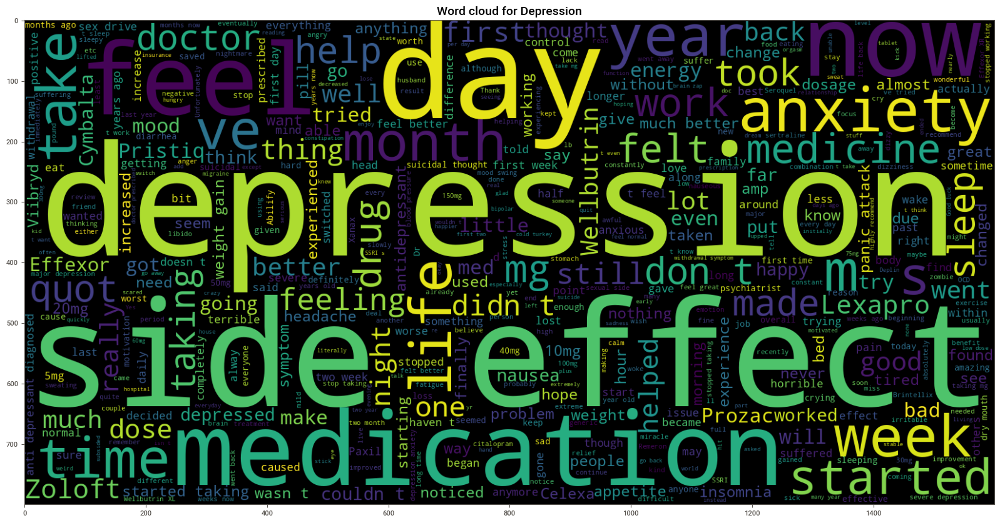

In [78]:
from wordcloud import WordCloud
plt.figure(figsize = (20,20)) # Text that is Fake News Headlines
wc = WordCloud(max_words = 500 , width = 1600 , height = 800).generate(" ".join(X_dep.review))
plt.imshow(wc , interpolation = 'bilinear')
plt.title('Word cloud for Depression',fontsize=14)

Text(0.5, 1.0, 'Word cloud for High Blood Pressure')

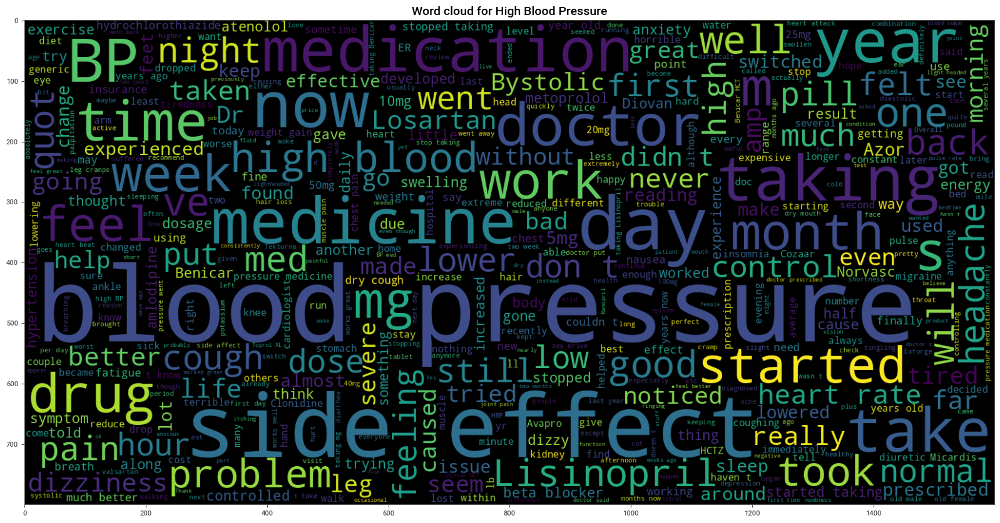

In [79]:
plt.figure(figsize = (20,20)) # Text that is Fake News Headlines
wc = WordCloud(max_words = 500 , width = 1600 , height = 800).generate(" ".join(X_bp.review))
plt.imshow(wc , interpolation = 'bilinear')
plt.title('Word cloud for High Blood Pressure',fontsize=14)

Text(0.5, 1.0, 'Word cloud for Diabetes Type 2')

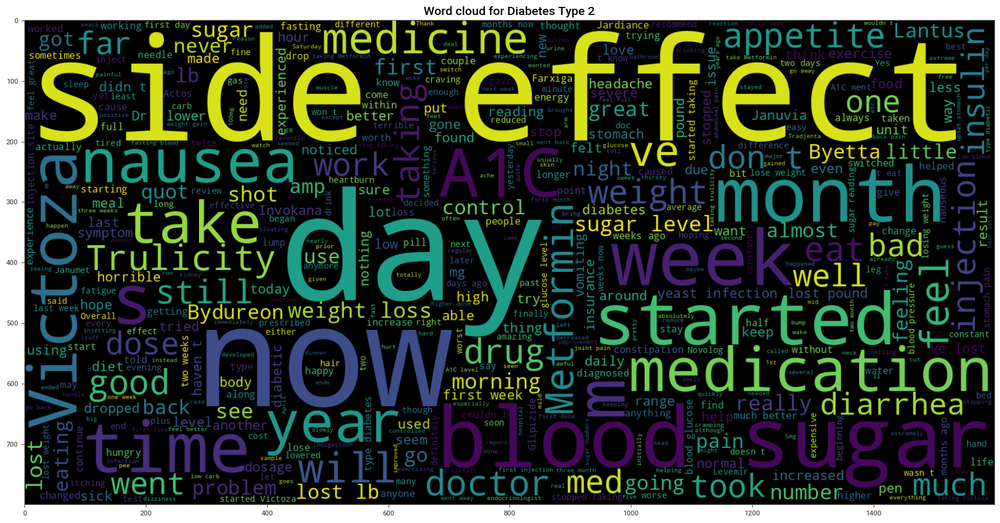

In [80]:
plt.figure(figsize = (20,20)) # Text that is Fake News Headlines
wc = WordCloud(max_words = 500 , width = 1600 , height = 800).generate(" ".join(X_diab.review))
plt.imshow(wc , interpolation = 'bilinear')
plt.title('Word cloud for Diabetes Type 2',fontsize=14)

**Data preprocessing**

In [81]:
X['review']

11        "I have taken anti-depressants for years, with...
31        "1 week on Zoloft for anxiety and mood swings....
44        "my gp started me on Venlafaxine yesterday to ...
50        "Hey Guys,  It&#039;s been 4 months since my l...
67        "This medicine saved my life. I was at my wits...
81        "Started taking it and I slept well at night a...
96        "Intake Effexor XR 375 mg, and lorazepam for d...
104       "My blood pressure has been around 160/100. Do...
143       "This medication is amazing! After 3 days of b...
146       "I was recently referred to a endocrinologist ...
150       "My genius psychiatrist started me on this dru...
153       "I was really glad that I experienced none of ...
169       "This drug causes persistent nausea in some us...
182       "have only been on victorza for a few days.  I...
184       "F/26, Wellbutrin SR 100mg twice a day &amp; I...
185       "I&#039;m a 27 year old white male in good sha...
187       "I have been taking Jardiance 

In [82]:
for i, col in enumerate(X.columns):
    X.iloc[:, i] = X.iloc[:, i].str.replace('"', '')

In [83]:
# To set the width of the column to maximum
pd.set_option('max_colwidth', -1)

<ipython-input-83-a7edaab304c3>:2: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('max_colwidth', -1)


In [84]:
X.head()

,condition,review
11,Depression,"I have taken anti-depressants for years, with some improvement but mostly moderate to severe side affects, which makes me go off them.\r\n\r\nI only take Cymbalta now mostly for pain.\r\n\r\nWhen I began Deplin, I noticed a major improvement overnight. More energy, better disposition, and no sinking to the low lows of major depression. I have been taking it for about 3 months now and feel like a normal person for the first time ever. Best thing, no side effects."
31,Depression,1 week on Zoloft for anxiety and mood swings. I take 50mg in the mornings with my breakfast. Nausea on day one but that subsided as the week went on. I get the jitters about 2 hrs after taking it followed by yawning. I feel much better though and less angry/stressed.
44,Depression,"my gp started me on Venlafaxine yesterday to help with depression and the change,a hour after taking them i was feeling very sick couldn,t stomach food or fluids, thought keep it up as she told me they did come with some side effects which would get better,took another one last night and was so ill i couldn,t stand ,being sick sweating shaking thought i was going to pass out. Did get some sleep hopeing to feel better this morning,took another one and felt so spaced out dry mouth shaking ,sick, so booked in to see gp again to make sure i should be feeling like this, only to find out she had put me on the wrong dose should have been on 37.5mg was put on 150mg, now on right dose hope this will be better"
50,"Diabetes, Type 2","Hey Guys, It&#039;s been 4 months since my last post as I wanted to give it a few months to see how this was going to work. So, I have been on Trulicity for six months now with Metformin. When I hit the five month period the diarrhea, gas, sulphur belching finally subsided. I now longer have any of those side effects. However, I still haven&#039;t lost any weight at all, but I think that was because when I first started Trulicity I was taking it with Glimepiride and that one has a side effect of weight gain so I think the two meds were fighting each other lol. I have been back on the Metformin with Trulicity for about a week now, so we will see what this does. I was diagnosed as stage 3 chronic kidney disease (CKD 3) so I am watching diet closely."
67,Depression,"This medicine saved my life. I was at my wits end with anti-depressants and was ready to give up. My doctor finally prescribed me this after many failed medications, I am so glad she did. I honestly do not know where I would be without Effexor XR. Side effects were very mild compared to other anti-depressants I tried. I was drowsy for the first couple days, but it was tolerable. I highly recommend this for severe depression. I would also like to mention for people to realize there is light at the end of the tunnel and YOU WILL GET BETTER, and to never give up."


**What are stopwords ?**

Stopwords are the most common words in any natural language. For the purpose of building NLP models, these stopwords might not add much value to the meaning of the document.

The most common words used in a text are “the”, “is”, “in”, “for”, “where”, “when”, “to”, “at” etc.

In [85]:
import nltk
from nltk.corpus import stopwords
nltk.download('stopwords')
stop = stopwords.words('english')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [86]:
stop

['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 "she's",
 'her',
 'hers',
 'herself',
 'it',
 "it's",
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 "that'll",
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each

**Lemmitization**

Lemmatization usually refers to doing things properly with the use of a vocabulary and morphological analysis of words, normally aiming to remove inflectional endings only and to return the base or dictionary form of a word, which is known as the lemma .

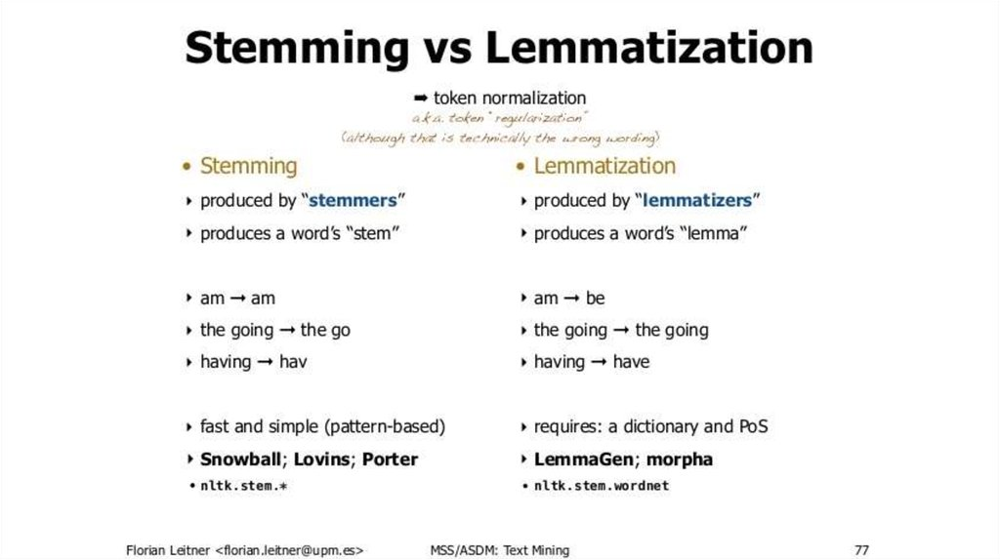

In [87]:
from IPython.display import Image
Image(filename='stem.jpg')

In [88]:
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer

porter = PorterStemmer()

lemmatizer = WordNetLemmatizer()

In [89]:
print(porter.stem("sportingly"))
print(porter.stem("very"))
print(porter.stem("troubled"))

sportingli
veri
troubl


In [90]:
nltk.download('wordnet')
print(lemmatizer.lemmatize("sportingly"))
print(lemmatizer.lemmatize("very"))
print(lemmatizer.lemmatize("troubled"))

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


sportingly
very
troubled


In [91]:
from bs4 import BeautifulSoup
import re

In [92]:
def review_to_words(raw_review):
    # 1. Delete HTML 
    review_text = BeautifulSoup(raw_review, 'html.parser').get_text()
    # 2. Make a space
    letters_only = re.sub('[^a-zA-Z]', ' ', review_text)
    # 3. lower letters
    words = letters_only.lower().split()
    # 5. Stopwords 
    meaningful_words = [w for w in words if not w in stop]
    # 6. lemmitization
    lemmitize_words = [lemmatizer.lemmatize(w) for w in meaningful_words]
    # 7. space join words
    return( ' '.join(lemmitize_words))

In [93]:
X['review_clean'] = X['review'].apply(review_to_words)

<ipython-input-92-96d5791fc591>:3: MarkupResemblesLocatorWarning: The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.
  review_text = BeautifulSoup(raw_review, 'html.parser').get_text()


In [94]:
X.head()

,condition,review,review_clean
11,Depression,"I have taken anti-depressants for years, with some improvement but mostly moderate to severe side affects, which makes me go off them.\r\n\r\nI only take Cymbalta now mostly for pain.\r\n\r\nWhen I began Deplin, I noticed a major improvement overnight. More energy, better disposition, and no sinking to the low lows of major depression. I have been taking it for about 3 months now and feel like a normal person for the first time ever. Best thing, no side effects.",taken anti depressant year improvement mostly moderate severe side affect make go take cymbalta mostly pain began deplin noticed major improvement overnight energy better disposition sinking low low major depression taking month feel like normal person first time ever best thing side effect
31,Depression,1 week on Zoloft for anxiety and mood swings. I take 50mg in the mornings with my breakfast. Nausea on day one but that subsided as the week went on. I get the jitters about 2 hrs after taking it followed by yawning. I feel much better though and less angry/stressed.,week zoloft anxiety mood swing take mg morning breakfast nausea day one subsided week went get jitter hr taking followed yawning feel much better though le angry stressed
44,Depression,"my gp started me on Venlafaxine yesterday to help with depression and the change,a hour after taking them i was feeling very sick couldn,t stomach food or fluids, thought keep it up as she told me they did come with some side effects which would get better,took another one last night and was so ill i couldn,t stand ,being sick sweating shaking thought i was going to pass out. Did get some sleep hopeing to feel better this morning,took another one and felt so spaced out dry mouth shaking ,sick, so booked in to see gp again to make sure i should be feeling like this, only to find out she had put me on the wrong dose should have been on 37.5mg was put on 150mg, now on right dose hope this will be better",gp started venlafaxine yesterday help depression change hour taking feeling sick stomach food fluid thought keep told come side effect would get better took another one last night ill stand sick sweating shaking thought going pas get sleep hopeing feel better morning took another one felt spaced dry mouth shaking sick booked see gp make sure feeling like find put wrong dose mg put mg right dose hope better
50,"Diabetes, Type 2","Hey Guys, It&#039;s been 4 months since my last post as I wanted to give it a few months to see how this was going to work. So, I have been on Trulicity for six months now with Metformin. When I hit the five month period the diarrhea, gas, sulphur belching finally subsided. I now longer have any of those side effects. However, I still haven&#039;t lost any weight at all, but I think that was because when I first started Trulicity I was taking it with Glimepiride and that one has a side effect of weight gain so I think the two meds were fighting each other lol. I have been back on the Metformin with Trulicity for about a week now, so we will see what this does. I was diagnosed as stage 3 chronic kidney disease (CKD 3) so I am watching diet closely.",hey guy month since last post wanted give month see going work trulicity six month metformin hit five month period diarrhea gas sulphur belching finally subsided longer side effect however still lost weight think first started trulicity taking glimepiride one side effect weight gain think two med fighting lol back metformin trulicity week see diagnosed stage chronic kidney disease ckd watching diet closely
67,Depression,"This medicine saved my life. I was at my wits end with anti-depressants and was ready to give up. My doctor finally prescribed me this after many failed medications, I am so glad she did. I honestly do not know where I would be without Effexor XR. Side effects were very mild compared to other anti-depressants I tried. I was drowsy for the first couple days, but it was tolerable. I highly recomme

**Creating features and Target Variable**

In [95]:
X_feat=X['review_clean']
y=X['condition']

In [96]:

X_train, X_test, y_train, y_test = train_test_split(X_feat, y,stratify=y,test_size=0.2, random_state=0)

In [97]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    See full source and example: 
    http://scikit-learn.org/stable/auto_examples/model_selection/plot_confusion_matrix.html
    
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')


**Bag of Words**

In [98]:
count_vectorizer = CountVectorizer(stop_words='english')

count_train = count_vectorizer.fit_transform(X_train)

count_test = count_vectorizer.transform(X_test)

In [99]:
count_train

<11155x11173 sparse matrix of type '<class 'numpy.int64'>'
	with 329230 stored elements in Compressed Sparse Row format>

**Machine Learning Model : Random Forest Classifier**

In [100]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

In [101]:
# Train a Random Forest Classifier
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(count_train, y_train)

RandomForestClassifier(random_state=42)

accuracy:   0.966
Confusion matrix, without normalization


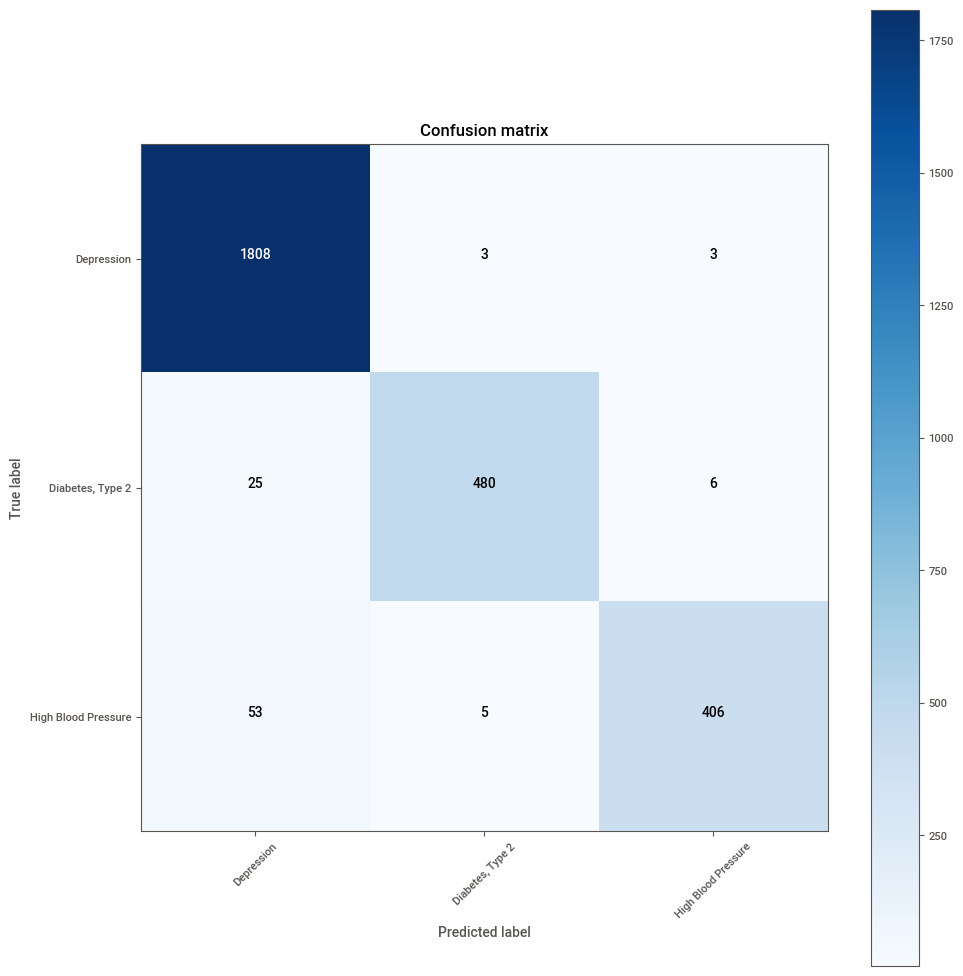

In [102]:
# Evaluate the model on the test set
pred = rf.predict(count_test)
score = metrics.accuracy_score(y_test, pred)
print("accuracy:   %0.3f" % score)

cm = metrics.confusion_matrix(y_test, pred, labels=['Depression','Diabetes, Type 2','High Blood Pressure'])
plot_confusion_matrix(cm, classes=['Depression','Diabetes, Type 2','High Blood Pressure'])

**Machine Learning Model : SVM Model(support vector machine)**

In [103]:
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix
import seaborn as sns

In [104]:
# Train a SVM classifier
svm = SVC(kernel='linear', C=1.0, random_state=42)
svm.fit(count_train, y_train)

SVC(kernel='linear', random_state=42)

accuracy:   0.951
Confusion matrix, without normalization


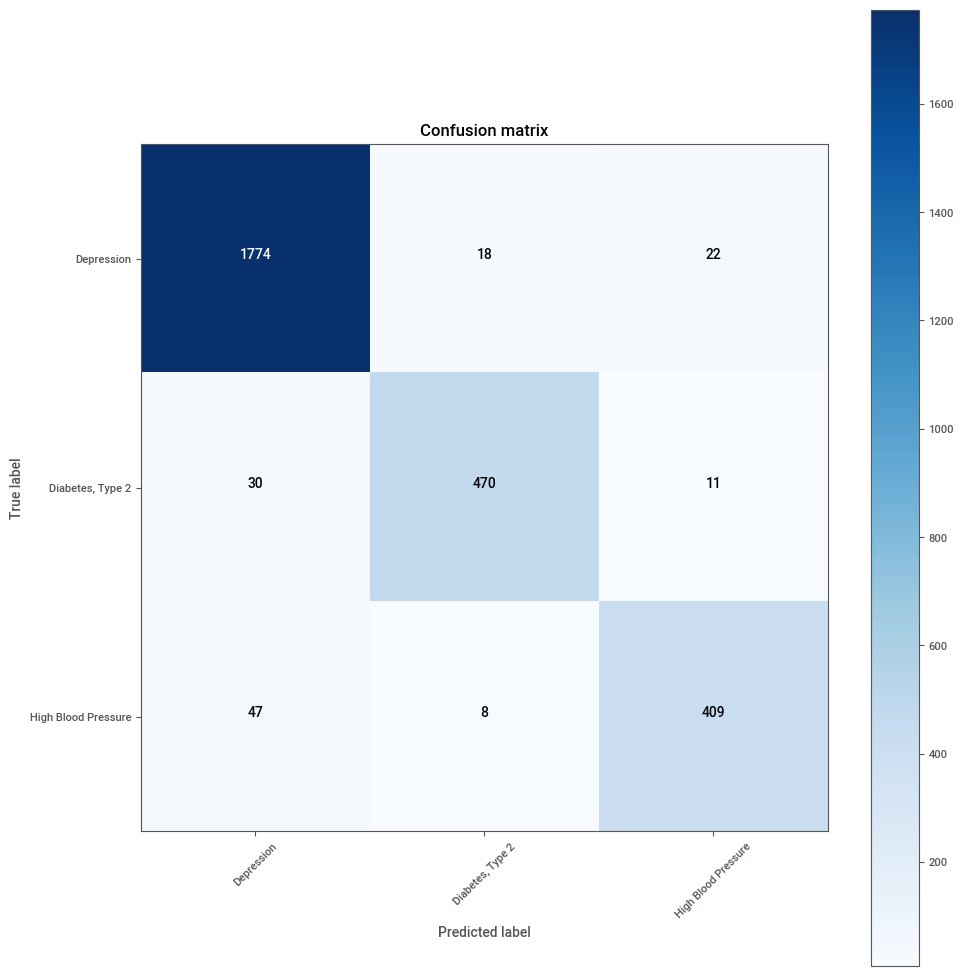

In [105]:
# Evaluate the model on the test set
pred = svm.predict(count_test)
score = metrics.accuracy_score(y_test, pred)
print("accuracy:   %0.3f" % score)

cm = metrics.confusion_matrix(y_test, pred, labels=['Depression','Diabetes, Type 2','High Blood Pressure'])
plot_confusion_matrix(cm, classes=['Depression','Diabetes, Type 2','High Blood Pressure'])

**Machine Learning Model :Gradient Boosting Classifier**

In [106]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV

In [107]:
# Training the Model
gb = GradientBoostingClassifier(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)
gb.fit(count_train, y_train)

GradientBoostingClassifier(random_state=42)

accuracy:   0.932
Confusion matrix, without normalization


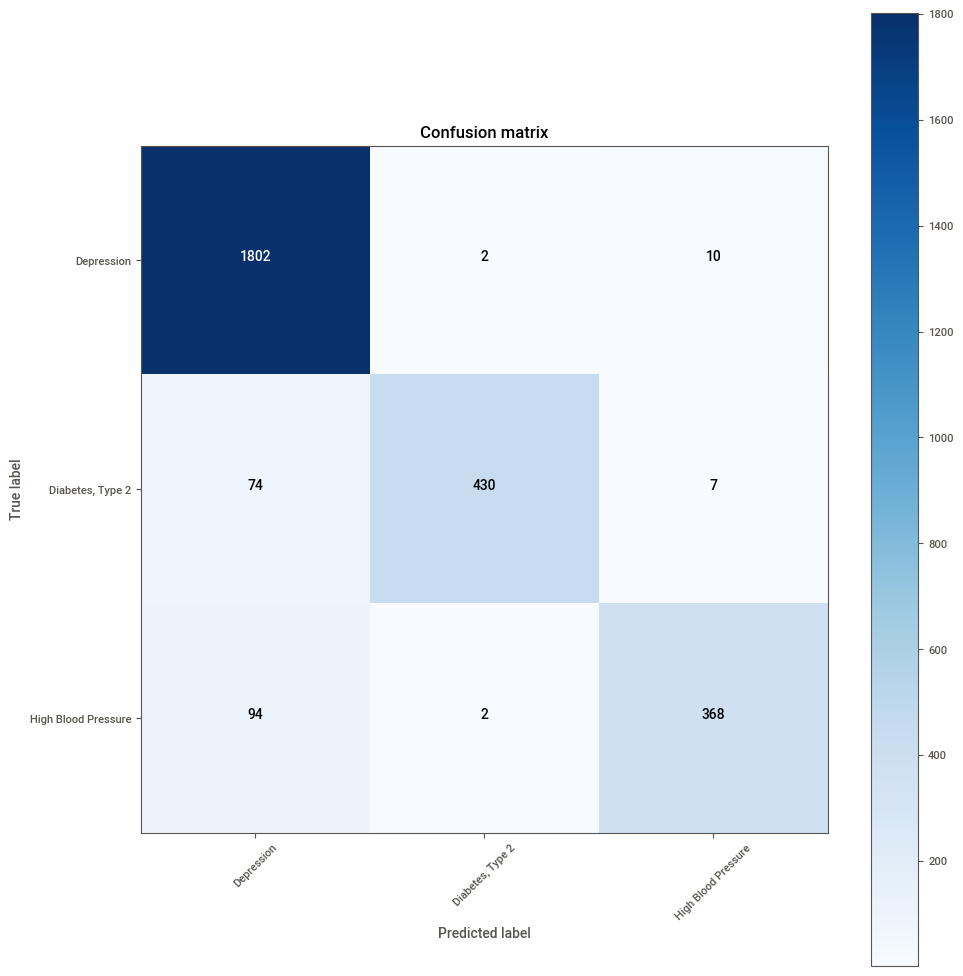

In [108]:
# Evaluate the model on the test set
pred = gb.predict(count_test)
score = metrics.accuracy_score(y_test, pred)
print("accuracy:   %0.3f" % score)

cm = metrics.confusion_matrix(y_test, pred, labels=['Depression','Diabetes, Type 2','High Blood Pressure'])
plot_confusion_matrix(cm, classes=['Depression','Diabetes, Type 2','High Blood Pressure'])

**Machine Learning Model : Naive Bayes**

accuracy:   0.955
Confusion matrix, without normalization


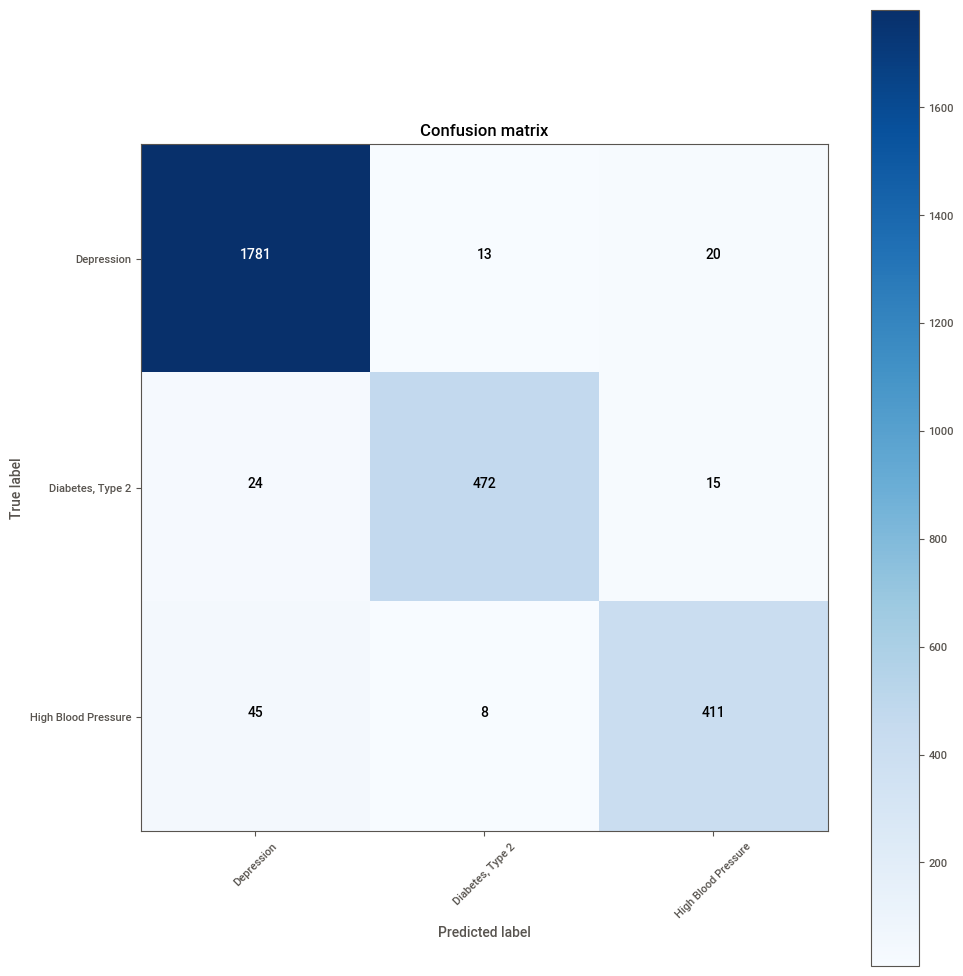

In [109]:
mnb = MultinomialNB()
mnb.fit(count_train, y_train)
pred = mnb.predict(count_test)
score = metrics.accuracy_score(y_test, pred)
print("accuracy:   %0.3f" % score)

cm = metrics.confusion_matrix(y_test, pred, labels=[ 'Depression','Diabetes, Type 2','High Blood Pressure'])
plot_confusion_matrix(cm, classes=['Depression','Diabetes, Type 2','High Blood Pressure'])

**Machine Learning Model : Passive Aggressive Classifier**

accuracy:   0.951
Confusion matrix, without normalization


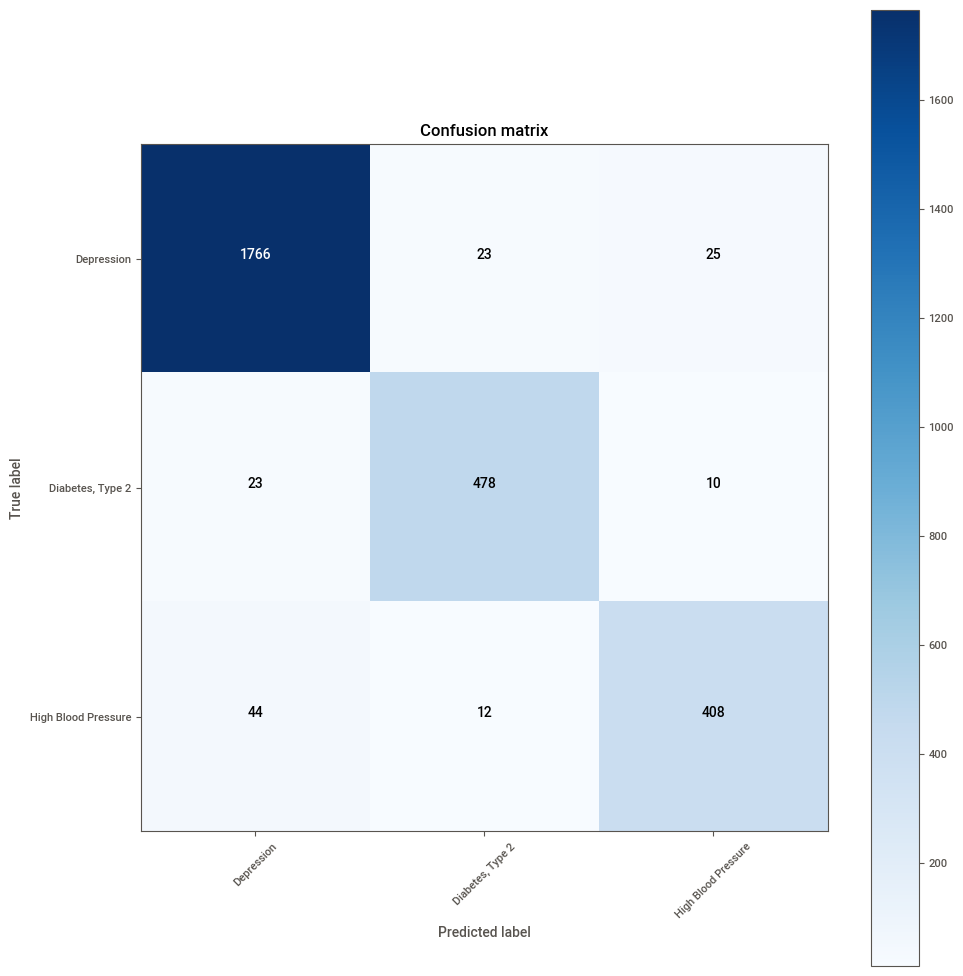

In [110]:
from sklearn.linear_model import PassiveAggressiveClassifier,LogisticRegression

passive = PassiveAggressiveClassifier()
passive.fit(count_train, y_train)
pred = passive.predict(count_test)
score = metrics.accuracy_score(y_test, pred)
print("accuracy:   %0.3f" % score)
cm = metrics.confusion_matrix(y_test, pred, labels=['Depression','Diabetes, Type 2','High Blood Pressure'])
plot_confusion_matrix(cm, classes=['Depression','Diabetes, Type 2','High Blood Pressure'])

**TFIDF**

In [111]:
from sklearn.feature_extraction.text import TfidfVectorizer

tfidf_vectorizer = TfidfVectorizer(stop_words='english', max_df=0.8)
tfidf_train_2 = tfidf_vectorizer.fit_transform(X_train)
tfidf_test_2 = tfidf_vectorizer.transform(X_test)

**Machine Learning Model TFIDF Random Forest Classifier**

accuracy:   0.968
Confusion matrix, without normalization


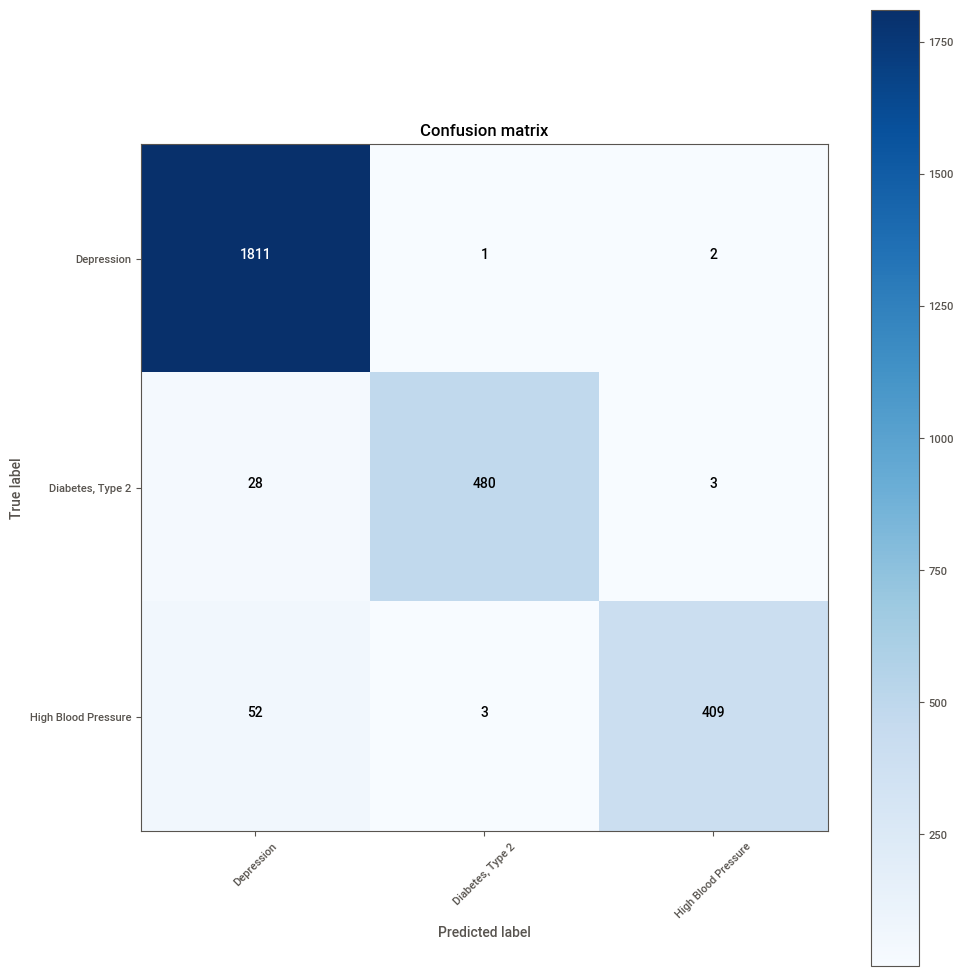

In [112]:
rf_tf = RandomForestClassifier()
rf_tf.fit(tfidf_train_2, y_train)
pred = rf_tf.predict(tfidf_test_2)
score = metrics.accuracy_score(y_test, pred)
print("accuracy:   %0.3f" % score)
cm = metrics.confusion_matrix(y_test, pred, labels=['Depression','Diabetes, Type 2','High Blood Pressure'])
plot_confusion_matrix(cm, classes=['Depression','Diabetes, Type 2','High Blood Pressure'])

**Machine Learning Model : TFIDF SVM Model(support vector machine)**

accuracy:   0.958
Confusion matrix, without normalization


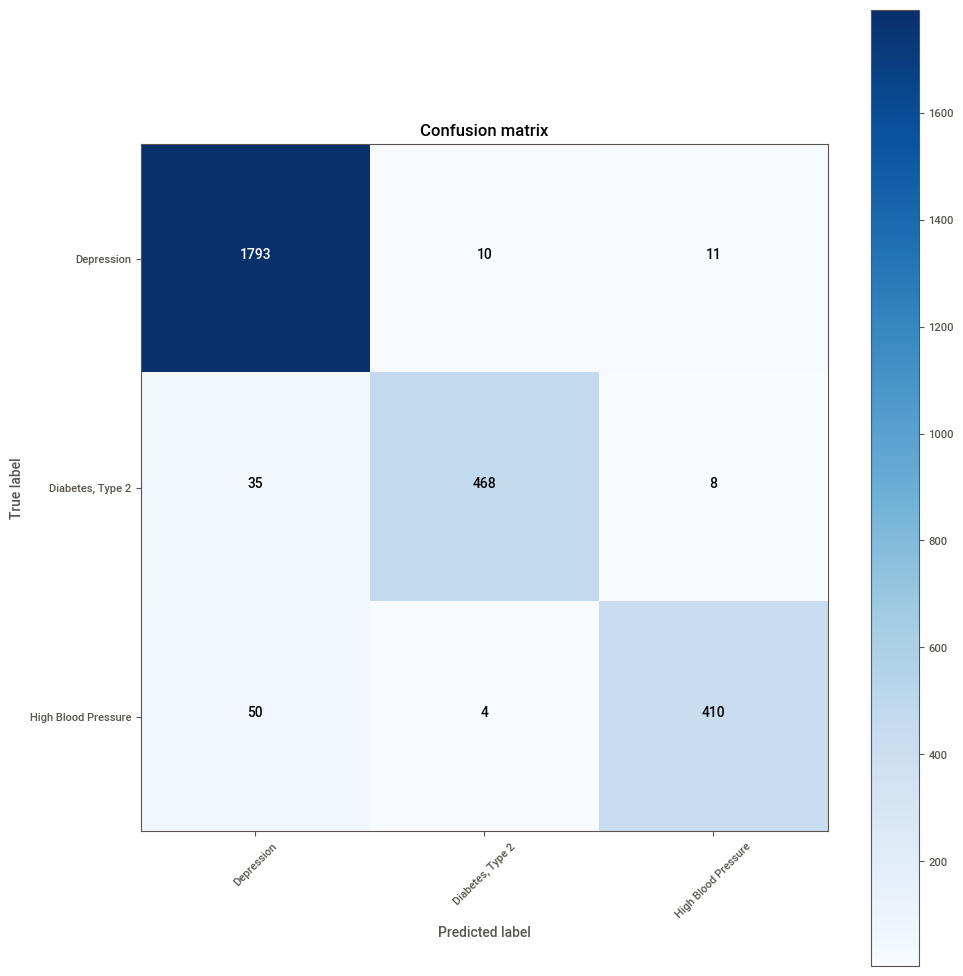

In [113]:
svm_tf = SVC(kernel='linear', C=1.0, random_state=42)
svm_tf.fit(tfidf_train_2, y_train)
pred = svm_tf.predict(tfidf_test_2)
score = metrics.accuracy_score(y_test, pred)
print("accuracy:   %0.3f" % score)
cm = metrics.confusion_matrix(y_test, pred, labels=['Depression','Diabetes, Type 2','High Blood Pressure'])
plot_confusion_matrix(cm, classes=['Depression','Diabetes, Type 2','High Blood Pressure'])

**Machine Learning Model :TFIDF Gradient Boosting Classifier**

accuracy:   0.931
Confusion matrix, without normalization


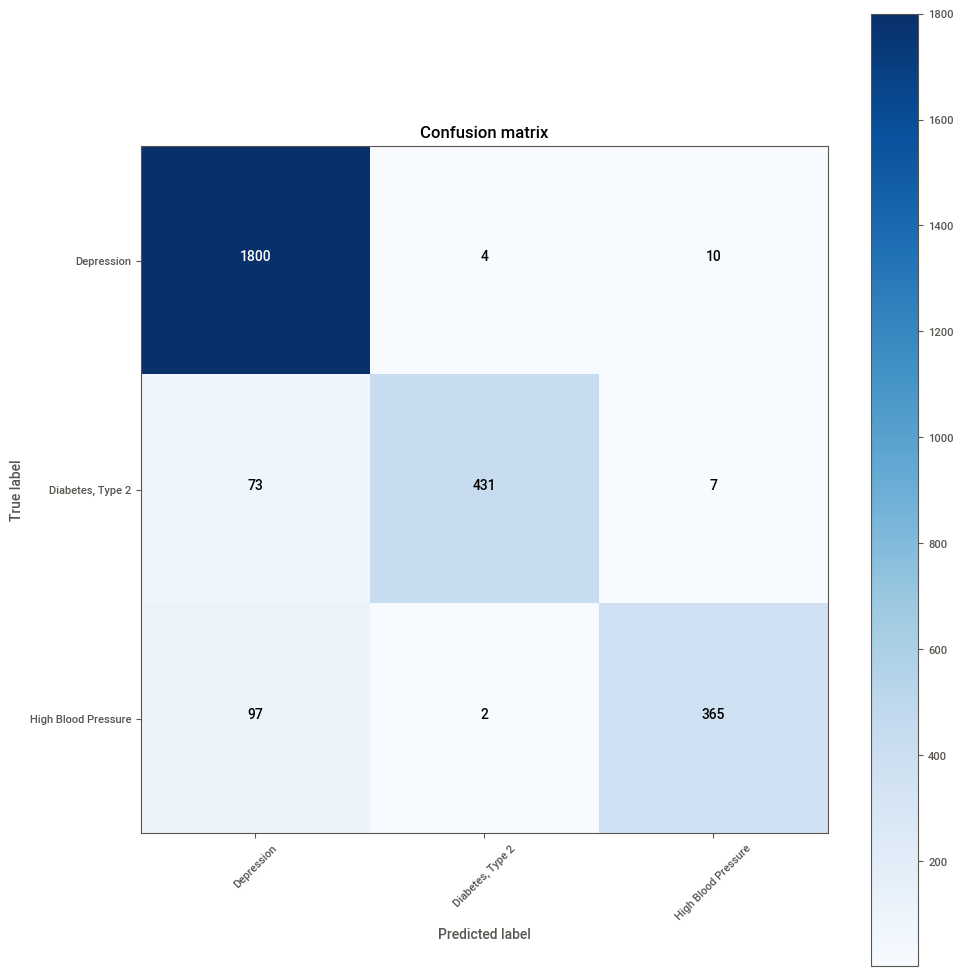

In [114]:
gb_tf = GradientBoostingClassifier(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)
gb_tf.fit(tfidf_train_2, y_train)
pred = gb_tf.predict(tfidf_test_2)
score = metrics.accuracy_score(y_test, pred)
print("accuracy:   %0.3f" % score)
cm = metrics.confusion_matrix(y_test, pred, labels=['Depression','Diabetes, Type 2','High Blood Pressure'])
plot_confusion_matrix(cm, classes=['Depression','Diabetes, Type 2','High Blood Pressure'])

**Machine Learning Model : TFIDF Naive Bayes**

accuracy:   0.896
Confusion matrix, without normalization


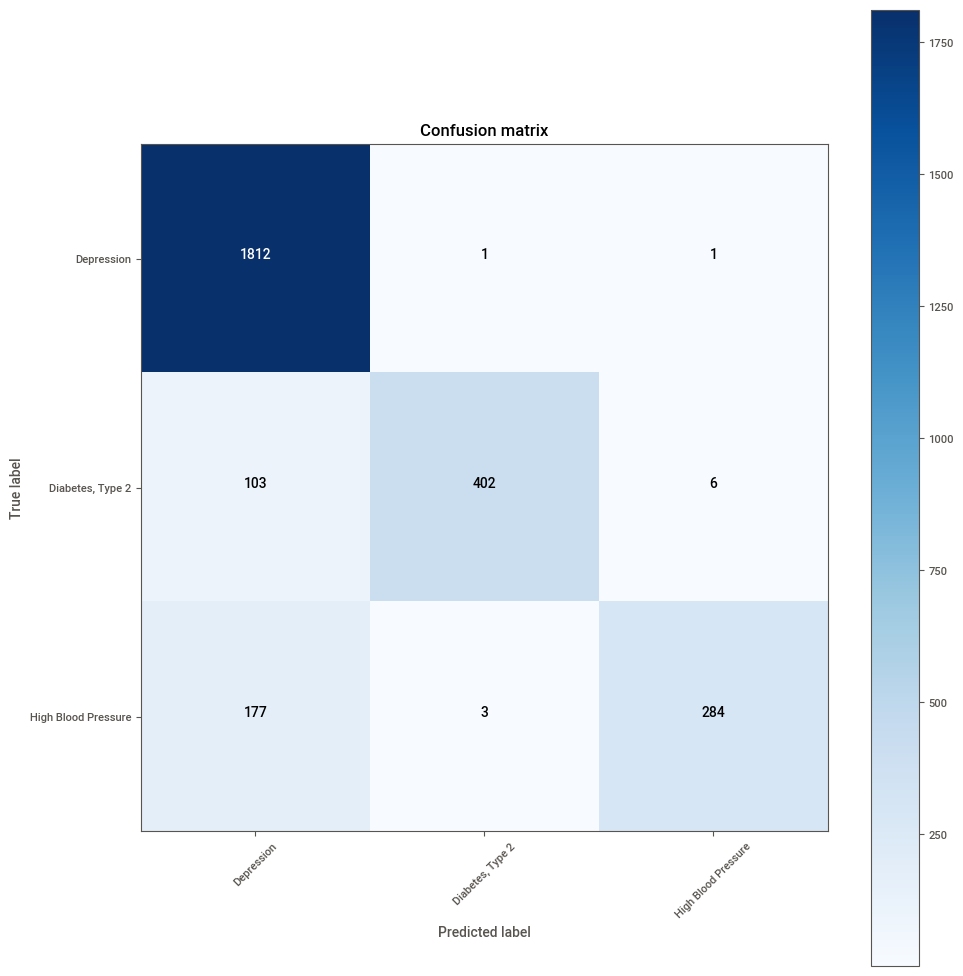

In [115]:
mnb_tf = MultinomialNB()
mnb_tf.fit(tfidf_train_2, y_train)
pred = mnb_tf.predict(tfidf_test_2)
score = metrics.accuracy_score(y_test, pred)
print("accuracy:   %0.3f" % score)
cm = metrics.confusion_matrix(y_test, pred, labels=['Depression','Diabetes, Type 2','High Blood Pressure'])
plot_confusion_matrix(cm, classes=['Depression','Diabetes, Type 2','High Blood Pressure'])

**Machine Learning Model: TFIDF Passive Aggressive Classifier**

accuracy:   0.959
Confusion matrix, without normalization


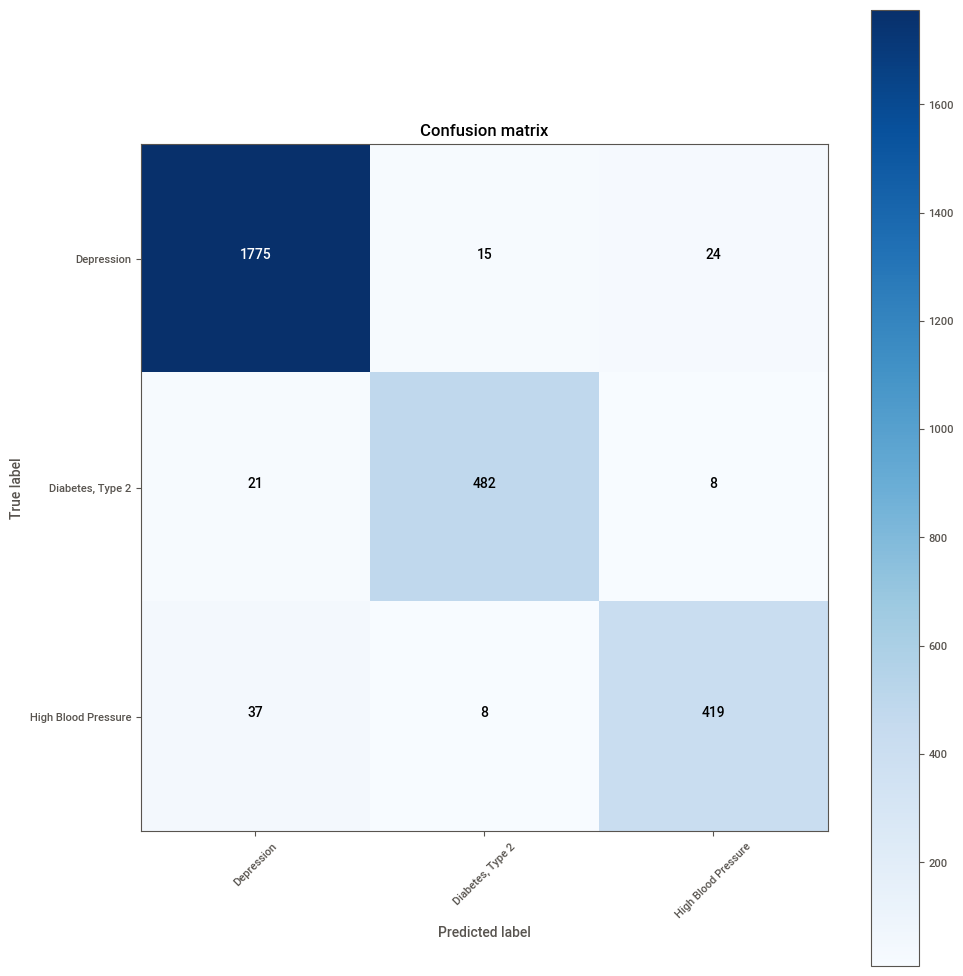

In [116]:
tfidf_vectorizer = TfidfVectorizer(stop_words='english', max_df=0.8)
tfidf_train = tfidf_vectorizer.fit_transform(X_train)
tfidf_test = tfidf_vectorizer.transform(X_test)

pass_tf = PassiveAggressiveClassifier()
pass_tf.fit(tfidf_train, y_train)
pred = pass_tf.predict(tfidf_test)
score = metrics.accuracy_score(y_test, pred)
print("accuracy:   %0.3f" % score)
cm = metrics.confusion_matrix(y_test, pred, labels=['Depression','Diabetes, Type 2','High Blood Pressure'])
plot_confusion_matrix(cm, classes=['Depression','Diabetes, Type 2','High Blood Pressure'])

**TFIDF: Bigrams**

In [117]:
tfidf_vectorizer2 = TfidfVectorizer(stop_words='english', max_df=0.8, ngram_range=(1,2))
tfidf_train_2 = tfidf_vectorizer2.fit_transform(X_train)
tfidf_test_2 = tfidf_vectorizer2.transform(X_test)

accuracy:   0.966
Confusion matrix, without normalization


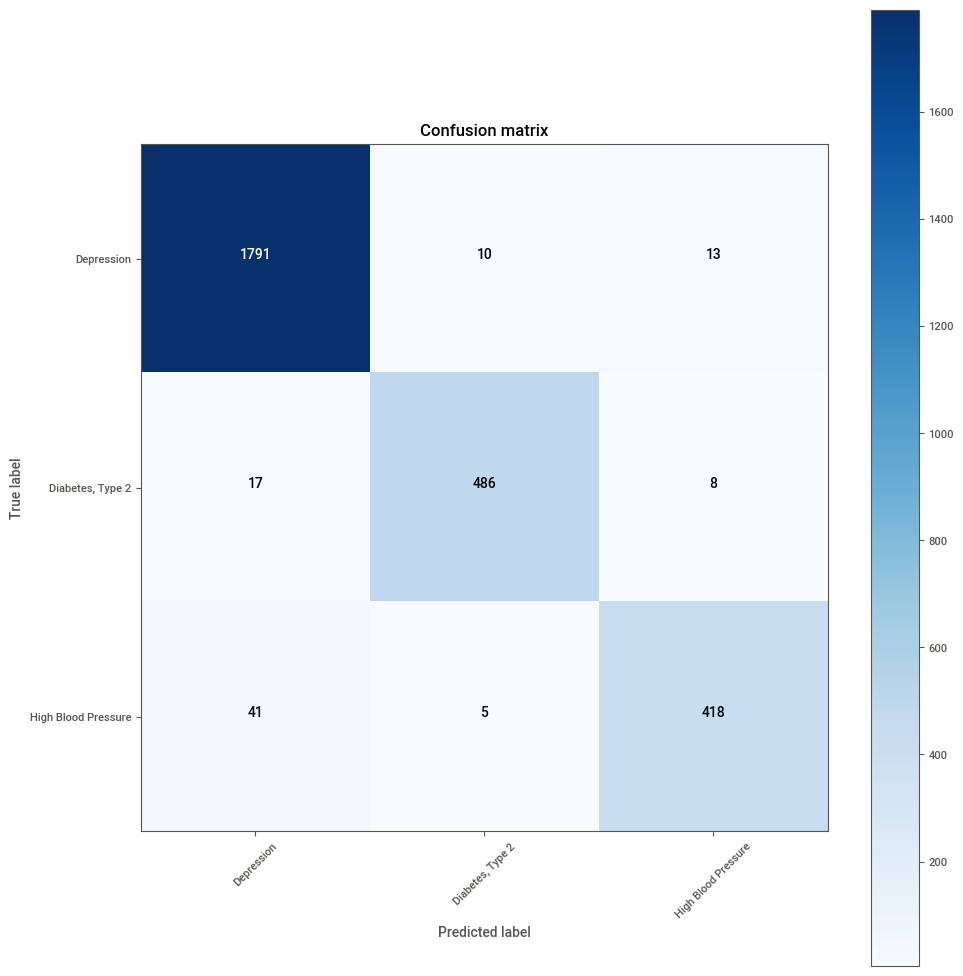

In [118]:
pass_tf = PassiveAggressiveClassifier()
pass_tf.fit(tfidf_train_2, y_train)
pred = pass_tf.predict(tfidf_test_2)
score = metrics.accuracy_score(y_test, pred)
print("accuracy:   %0.3f" % score)
cm = metrics.confusion_matrix(y_test, pred, labels=['Depression','Diabetes, Type 2','High Blood Pressure'])
plot_confusion_matrix(cm, classes=['Depression','Diabetes, Type 2','High Blood Pressure'])


**TFIDF : Trigrams**

accuracy:   0.967
Confusion matrix, without normalization


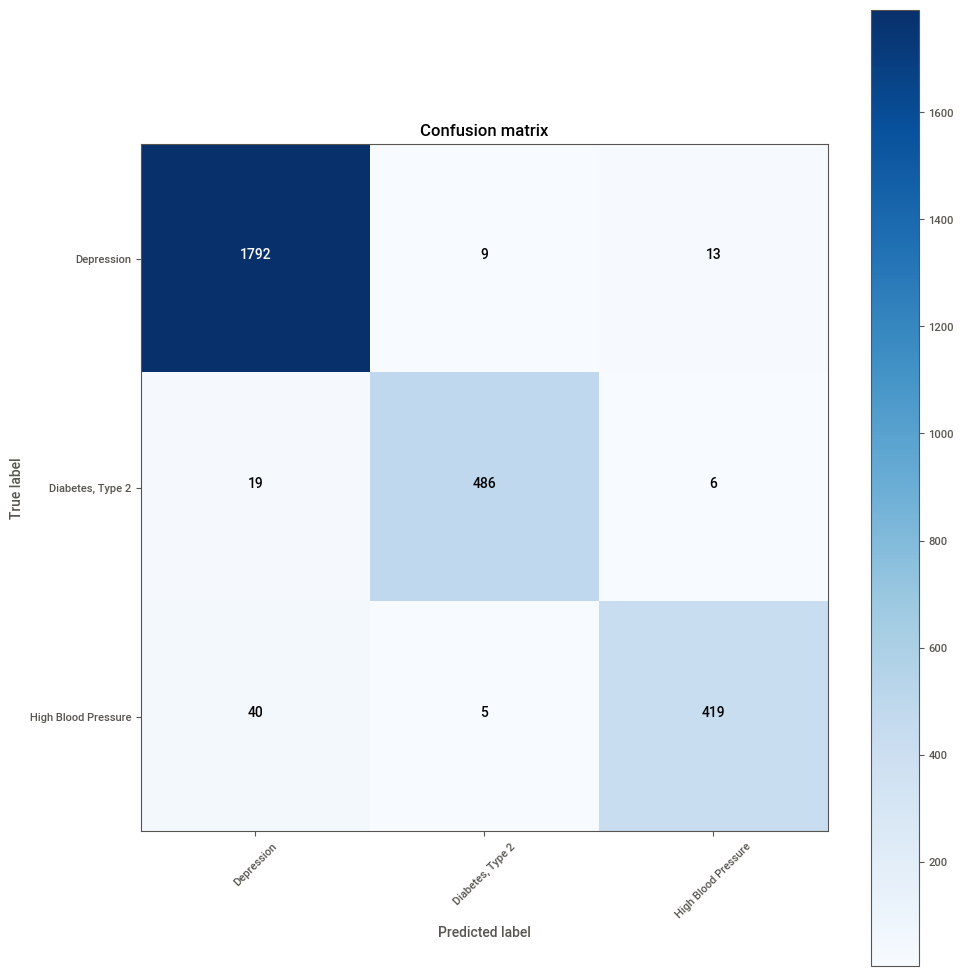

In [119]:
tfidf_vectorizer3 = TfidfVectorizer(stop_words='english', max_df=0.8, ngram_range=(1,3))
tfidf_train_3 = tfidf_vectorizer3.fit_transform(X_train)
tfidf_test_3 = tfidf_vectorizer3.transform(X_test)

pass_tf = PassiveAggressiveClassifier()
pass_tf.fit(tfidf_train_3, y_train)
pred = pass_tf.predict(tfidf_test_3)
score = metrics.accuracy_score(y_test, pred)
print("accuracy:   %0.3f" % score)
cm = metrics.confusion_matrix(y_test, pred, labels=['Depression','Diabetes, Type 2','High Blood Pressure'])
plot_confusion_matrix(cm, classes=['Depression','Diabetes, Type 2','High Blood Pressure'])

In [120]:
#Predictions

In [121]:
X.head()

,condition,review,review_clean
11,Depression,"I have taken anti-depressants for years, with some improvement but mostly moderate to severe side affects, which makes me go off them.\r\n\r\nI only take Cymbalta now mostly for pain.\r\n\r\nWhen I began Deplin, I noticed a major improvement overnight. More energy, better disposition, and no sinking to the low lows of major depression. I have been taking it for about 3 months now and feel like a normal person for the first time ever. Best thing, no side effects.",taken anti depressant year improvement mostly moderate severe side affect make go take cymbalta mostly pain began deplin noticed major improvement overnight energy better disposition sinking low low major depression taking month feel like normal person first time ever best thing side effect
31,Depression,1 week on Zoloft for anxiety and mood swings. I take 50mg in the mornings with my breakfast. Nausea on day one but that subsided as the week went on. I get the jitters about 2 hrs after taking it followed by yawning. I feel much better though and less angry/stressed.,week zoloft anxiety mood swing take mg morning breakfast nausea day one subsided week went get jitter hr taking followed yawning feel much better though le angry stressed
44,Depression,"my gp started me on Venlafaxine yesterday to help with depression and the change,a hour after taking them i was feeling very sick couldn,t stomach food or fluids, thought keep it up as she told me they did come with some side effects which would get better,took another one last night and was so ill i couldn,t stand ,being sick sweating shaking thought i was going to pass out. Did get some sleep hopeing to feel better this morning,took another one and felt so spaced out dry mouth shaking ,sick, so booked in to see gp again to make sure i should be feeling like this, only to find out she had put me on the wrong dose should have been on 37.5mg was put on 150mg, now on right dose hope this will be better",gp started venlafaxine yesterday help depression change hour taking feeling sick stomach food fluid thought keep told come side effect would get better took another one last night ill stand sick sweating shaking thought going pas get sleep hopeing feel better morning took another one felt spaced dry mouth shaking sick booked see gp make sure feeling like find put wrong dose mg put mg right dose hope better
50,"Diabetes, Type 2","Hey Guys, It&#039;s been 4 months since my last post as I wanted to give it a few months to see how this was going to work. So, I have been on Trulicity for six months now with Metformin. When I hit the five month period the diarrhea, gas, sulphur belching finally subsided. I now longer have any of those side effects. However, I still haven&#039;t lost any weight at all, but I think that was because when I first started Trulicity I was taking it with Glimepiride and that one has a side effect of weight gain so I think the two meds were fighting each other lol. I have been back on the Metformin with Trulicity for about a week now, so we will see what this does. I was diagnosed as stage 3 chronic kidney disease (CKD 3) so I am watching diet closely.",hey guy month since last post wanted give month see going work trulicity six month metformin hit five month period diarrhea gas sulphur belching finally subsided longer side effect however still lost weight think first started trulicity taking glimepiride one side effect weight gain think two med fighting lol back metformin trulicity week see diagnosed stage chronic kidney disease ckd watching diet closely
67,Depression,"This medicine saved my life. I was at my wits end with anti-depressants and was ready to give up. My doctor finally prescribed me this after many failed medications, I am so glad she did. I honestly do not know where I would be without Effexor XR. Side effects were very mild compared to other anti-depressants I tried. I was drowsy for the first couple days, but it was tolerable. I highly recomme

In [122]:
#Using Randomforest model to predict it should good accuracy among all

In [123]:
text =["This medicine saved my life. I was at my wits end with anti-depressants and was ready to give up. My doctor finally prescribed me this after many failed medications, I am so glad she did. I honestly do not know where I would be without Effexor XR. Side effects were very mild compared to other anti-depressants I tried. I was drowsy for the first couple days, but it was tolerable. I highly recommend this for severe depression. I would also like to mention for people to realize there is light at the end of the tunnel and YOU WILL GET BETTER, and to never give up."]
test = tfidf_vectorizer.transform(text)
pred1=rf_tf.predict(test)[0]
pred1

'Depression'

In [124]:
text =["I just got diagnosed with type 2. My doctor prescribed Invokana and metformin from the beginning. My sugars went down to normal by the second week. I am losing so much weight. No side effects yet. Miracle medicine for me"]
test = tfidf_vectorizer.transform(text)
pred1=rf_tf.predict(test)[0]
pred1

'Diabetes, Type 2'

In [125]:
text =["I have only been on Tekturna for 9 days. The effect was immediate. I am also on a calcium channel blocker (Tiazac) and hydrochlorothiazide. I was put on Tekturna because of palpitations experienced with Diovan (ugly drug in my opinion, same company produces both however). The palpitations were pretty bad on Diovan, 24 hour monitor by EKG etc. After a few days of substituting Tekturna for Diovan, there are no more palpitations."]
test = tfidf_vectorizer.transform(text)
pred1=rf_tf.predict(test)[0]
pred1

'High Blood Pressure'

In [126]:
## Function for Extracting Top drugs

def top_drugs_extractor(condition):
    df_top = df[(df['rating']>=9)&(df['usefulCount']>=100)].sort_values(by = ['rating', 'usefulCount'], ascending = [False, False])
    drug_lst = df_top[df_top['condition']==condition]['drugName'].head(3).tolist()
    return drug_lst

In [127]:
def predict_text(lst_text):
    df_test = pd.DataFrame(lst_text, columns = ['test_sent'])
    df_test["test_sent"] = df_test["test_sent"].apply(review_to_words)
    tfidf_bigram = tfidf_vectorizer.transform(lst_text)
    prediction = rf_tf.predict(tfidf_bigram)
    df_test['prediction']=prediction
    return df_test

In [128]:
sentences = [
  "I have only been on Tekturna for 9 days. The effect was immediate. I am also on a calcium channel blocker (Tiazac) and hydrochlorothiazide. I was put on Tekturna because of palpitations experienced with Diovan (ugly drug in my opinion, same company produces both however). The palpitations were pretty bad on Diovan, 24 hour monitor by EKG etc. After a few days of substituting Tekturna for Diovan, there are no more palpitations.",
    "This is the third med I&#039;ve tried for anxiety and mild depression. Been on it for a week and I hate it so much. I am so dizzy, I have major diarrhea and feel worse than I started. Contacting my doc in the am and changing asap.",
    "I just got diagnosed with type 2. My doctor prescribed Invokana and metformin from the beginning. My sugars went down to normal by the second week. I am losing so much weight. No side effects yet. Miracle medicine for me",
    
  ]

In [129]:
tfidf_trigram = tfidf_vectorizer.transform(sentences)


predictions = rf_tf.predict(tfidf_trigram)

for text, label in zip(sentences, predictions):
    if label=="High Blood Pressure":
        target="High Blood Pressure"
        top_drugs = top_drugs_extractor(label)
        print("text:", text, "\nCondition:", target)
        print("Top 3 Suggested Drugs:")
        print(top_drugs[0])
        print(top_drugs[1])
        print(top_drugs[2])
        print()
    elif label=="Depression":
        target="Depression"
        top_drugs = top_drugs_extractor(label)
        print("text:", text, "\nCondition:", target)
        print("Top 3 Suggested Drugs:")
        print(top_drugs[0])
        print(top_drugs[1])
        print(top_drugs[2])
        print()
    else: 
          target="Diabetes, Type 2"
          top_drugs = top_drugs_extractor(label)
          print("text:", text, "\nCondition:", target)
          print("Top 3 Suggested Drugs:")
          print(top_drugs[0])
          print(top_drugs[1])
          print(top_drugs[2])
          print()
    

text: I have only been on Tekturna for 9 days. The effect was immediate. I am also on a calcium channel blocker (Tiazac) and hydrochlorothiazide. I was put on Tekturna because of palpitations experienced with Diovan (ugly drug in my opinion, same company produces both however). The palpitations were pretty bad on Diovan, 24 hour monitor by EKG etc. After a few days of substituting Tekturna for Diovan, there are no more palpitations. 
Condition: High Blood Pressure
Top 3 Suggested Drugs:
Losartan
Aldactone
Spironolactone

text: This is the third med I&#039;ve tried for anxiety and mild depression. Been on it for a week and I hate it so much. I am so dizzy, I have major diarrhea and feel worse than I started. Contacting my doc in the am and changing asap. 
Condition: Depression
Top 3 Suggested Drugs:
Sertraline
Zoloft
Viibryd

text: I just got diagnosed with type 2. My doctor prescribed Invokana and metformin from the beginning. My sugars went down to normal by the second week. I am losi